In [5]:
import illustris_python as il
import mistree as mist
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import astropy.units as u
import astropy.constants as c
import pandas as pd
import networkx as nx
import seaborn as sns
import scienceplots

from sklearn.neighbors import radius_neighbors_graph, KernelDensity

from scipy.spatial import Delaunay
from scipy.spatial.distance import euclidean, minkowski
from sklearn.preprocessing import PowerTransformer

import Utilities as ut
import Network_stats as ns

from collections import OrderedDict

from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split

import seaborn as sns
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch_geometric.data import Data
from torch_geometric.utils import from_networkx
from sklearn.utils.class_weight import compute_class_weight
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch_geometric.nn import GCNConv
from torch_geometric.nn import GATv2Conv


plt.style.use(['science','no-latex', 'dark_background'])

In [6]:
import os
os.getcwd()

'/global/u2/d/dkololgi/TNG/Illustris'

In [7]:
# testcat = ut.cat(path=r'/Users/daksheshkololgi/Library/CloudStorage/OneDrive-UniversityCollegeLondon/Year 1/Illustris/TNG300-1', snapno=99, masscut=1e9)

In [8]:
test = ns.network(masscut=1e9)

There are 283969 subhalos with stellar mass greater than 0.06774.


In [9]:
G = test.subhalo_delauany_network(xyzplot=False)

In [10]:
test.cweb_classify(xyzplot=False)

In [11]:
test.network_stats_delaunay(buffer=False)

length before buffering:  283969
Class weights (pre-buffer):  [6.58983106 1.02858995 0.55451865 0.93224406]
length after buffering:  283969


In [12]:
test.data

,Degree,Mean E.L.,Min E.L.,Max E.L.,Clustering,Density,Neigh Density,I_eig1,I_eig2,I_eig3,Target
Node ID,,,,,,,,,,,
0,3.979139,0.209428,0.118046,0.325785,0.000212,375.917255,918.529068,0.009284,0.017015,0.018664,3.0
1,2.049505,0.146393,0.070603,0.229360,0.000201,2160.113994,1998.211578,0.004750,0.006537,0.009778,3.0
2,3.176717,0.317672,0.032403,0.551327,0.000677,129.093634,48.940531,0.026849,0.038293,0.052121,3.0
3,7.288933,0.560687,0.044699,1.320098,0.000749,8.441822,314.851169,0.052464,0.139263,0.295583,3.0
4,4.030514,0.403051,0.047626,0.714933,0.000687,45.007940,15.812897,0.020225,0.044837,0.129749,3.0
...,...,...,...,...,...,...,...,...,...,...,...
283964,9.076247,1.296607,0.517913,3.402013,0.003265,0.788000,0.501807,0.079226,0.464745,1.884503,3.0
283965,33.390794,2.226053,0.304603,3.200867,0.002756,0.076768,0.102348,0.979518,1.260196,2.819411,3.0
283966,61.446796,3.234042,0.879060,8.516660,0.003286,0.008032,0.664860,0.904824,4.277449,8.343144,3.0


In [13]:
# test.data.drop(columns=['I_eig1','I_eig2','I_eig3'], inplace=True)

In [14]:
# merge voids and walls
# test.data['Target'][test.data['Target'] == 1] = 0
# test.data['Target'][test.data['Target'] == 2] = 1
# test.data['Target'][test.data['Target'] == 3] = 2

# remove void galaxies
# test.data = test.data[test.data['Target'] != 0]

# test.data = test.data.drop(columns=['r', 'UB'])

In [15]:
features = test.data.iloc[:,:-1] # All columns except the last one
targets = test.data.iloc[:,-1] # The last column

# scaler = PowerTransformer()
scaler = PowerTransformer(method = 'box-cox')
features = pd.DataFrame(scaler.fit_transform(features), index=features.index, columns=features.columns)

In [16]:
features

,Degree,Mean E.L.,Min E.L.,Max E.L.,Clustering,Density,Neigh Density,I_eig1,I_eig2,I_eig3
Node ID,,,,,,,,,,
0,-1.646452,-1.958968,-1.039620,-2.169511,-2.141763,1.847816,1.788518,-1.732633,-1.901915,-2.129907
1,-1.973694,-2.090995,-1.328754,-2.295426,-2.157240,2.003026,1.878246,-1.859136,-2.072937,-2.243254
2,-1.762285,-1.781132,-1.725716,-1.948146,-1.687259,1.738827,1.394390,-1.497481,-1.729891,-1.918423
3,-1.308880,-1.488860,-1.567460,-1.473780,-1.632677,1.402361,1.655306,-1.323803,-1.393759,-1.451758
4,-1.639701,-1.666248,-1.535331,-1.822256,-1.679555,1.619479,1.215788,-1.564762,-1.693180,-1.692469
...,...,...,...,...,...,...,...,...,...,...
283964,-1.176465,-0.925278,-0.068934,-0.758633,-0.425765,1.026079,0.557484,-1.205841,-0.994359,-0.749496
283965,-0.262586,-0.455145,-0.442890,-0.812406,-0.615455,0.559821,0.186556,-0.256621,-0.585457,-0.560991
283966,0.251364,-0.069469,0.335281,0.212099,-0.418068,-0.007254,0.618307,-0.293719,0.036084,0.025087


In [17]:
targets

Node ID
0         3.0
1         3.0
2         3.0
3         3.0
4         3.0
         ... 
283964    3.0
283965    3.0
283966    3.0
283967    3.0
283968    2.0
Name: Target, Length: 283969, dtype: float64

In [18]:
targets[targets == 0]

Node ID
99866     0.0
100805    0.0
100806    0.0
100807    0.0
100808    0.0
         ... 
280906    0.0
281074    0.0
281188    0.0
281426    0.0
281727    0.0
Name: Target, Length: 10773, dtype: float64

In [17]:
stars = (testcat.object['subhalos']['SubhaloMassType'][:,4]) #stellar mass of subhalos
mc = 1e9*testcat.hub/1e10 #mass cut for subhalos
stars_indices = np.where(stars>=mc)[0] #indices of subhalos with stellar mass greater than masscut

NameError: name 'testcat' is not defined

In [14]:
np.shape(testcat.object['subhalos']['SubhaloStellarPhotometrics'][stars_indices])

NameError: name 'testcat' is not defined

In [15]:
magnitudes = testcat.object['subhalos']['SubhaloStellarPhotometrics'][stars_indices]

NameError: name 'testcat' is not defined

In [390]:
# U, B, V, K, g, r, i, z

U, B, V, K, g, r, i, z = magnitudes.T

# U-B, B-V, V-K, g-r, r-i, i-z
UB = U-B
BV = B-V
VK = V-K
gr = g-r
ri = r-i
iz = i-z



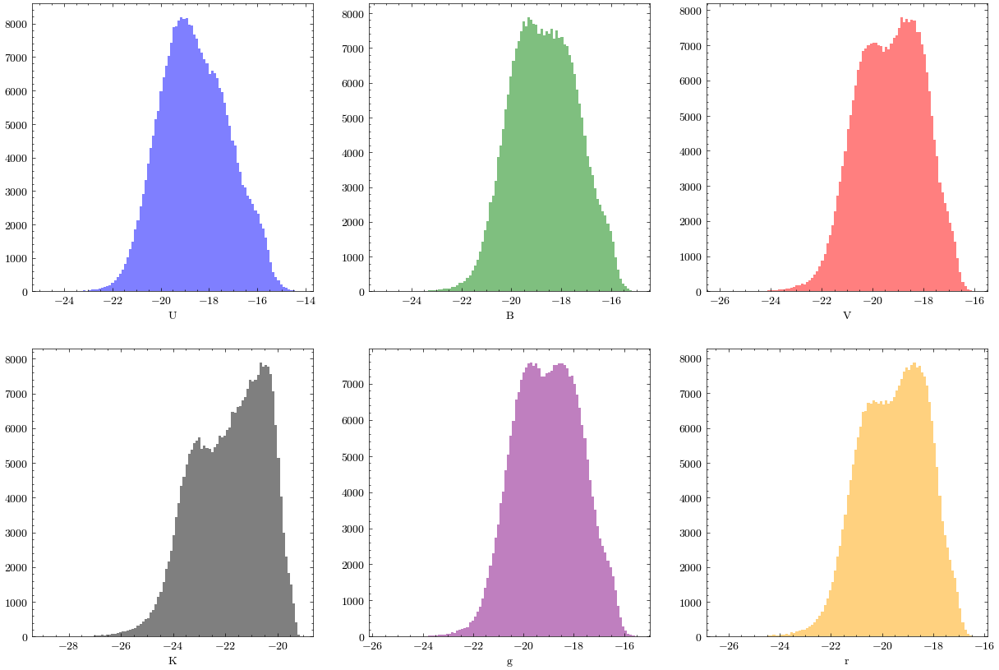

In [391]:
# histograms of luminosities
fig, ax = plt.subplots(2,3, figsize=(15,10))
ax[0,0].hist(U, bins=100, color='blue', alpha=0.5, label='U')
ax[0,1].hist(B, bins=100, color='green', alpha=0.5, label='B')
ax[0,2].hist(V, bins=100, color='red', alpha=0.5, label='V')
ax[1,0].hist(K, bins=100, color='black', alpha=0.5, label='K')
ax[1,1].hist(g, bins=100, color='purple', alpha=0.5, label='g')
ax[1,2].hist(r, bins=100, color='orange', alpha=0.5, label='r')
ax[0,0].set_xlabel('U')
ax[0,1].set_xlabel('B')
ax[0,2].set_xlabel('V')
ax[1,0].set_xlabel('K')
ax[1,1].set_xlabel('g')
ax[1,2].set_xlabel('r')
plt.show()



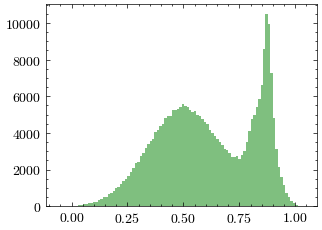

In [408]:
fig, ax = plt.subplots()
# ax.hist(UB, bins=100, color='blue', alpha=0.5, label='U-B')
ax.hist(BV, bins=100, color='green', alpha=0.5, label='B-V')
# ax.hist(VK, bins=100, color='red', alpha=0.5, label='V-K')
# ax.hist(gr, bins=100, color='black', alpha=0.5, label='g-r')
# ax.hist(ri, bins=100, color='purple', alpha=0.5, label='r-i')
# ax.hist(iz, bins=100, color='orange', alpha=0.5, label='i-z')
plt.show()

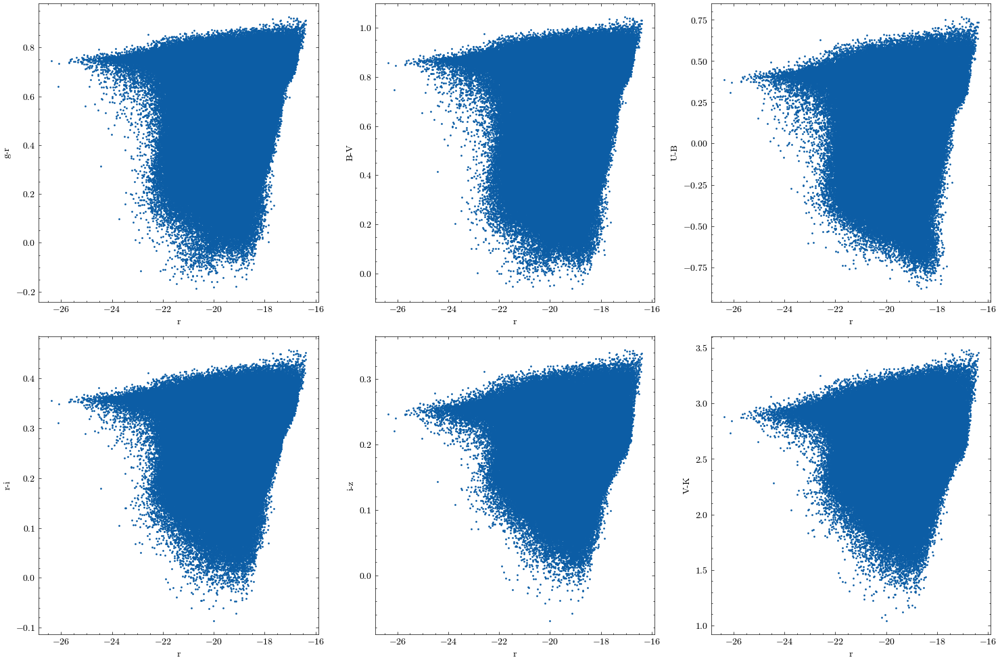

In [409]:
fig, ax = plt.subplots(2,3, figsize=(15,10))
ax[0,0].scatter(r, gr, s=1)
ax[0,0].set_xlabel('r')
ax[0,0].set_ylabel('g-r')
ax[0,1].scatter(r, BV, s=1)
ax[0,1].set_xlabel('r')
ax[0,1].set_ylabel('B-V')
ax[0,2].scatter(r, UB, s=1)
ax[0,2].set_xlabel('r')
ax[0,2].set_ylabel('U-B')
ax[1,0].scatter(r, ri, s=1)
ax[1,0].set_xlabel('r')
ax[1,0].set_ylabel('r-i')
ax[1,1].scatter(r, iz, s=1)
ax[1,1].set_xlabel('r')
ax[1,1].set_ylabel('i-z')
ax[1,2].scatter(r, VK, s=1)
ax[1,2].set_xlabel('r')
ax[1,2].set_ylabel('V-K')

plt.tight_layout()
plt.show()


In [152]:
# data = pd.read_csv('data_delaunay2.csv', index_col=0)

In [19]:
data = test.data

In [20]:
data

,Degree,Mean E.L.,Min E.L.,Max E.L.,Clustering,Density,Neigh Density,I_eig1,I_eig2,I_eig3,Target
Node ID,,,,,,,,,,,
0,3.979139,0.209428,0.118046,0.325785,0.000212,375.917255,918.529068,0.009284,0.017015,0.018664,3.0
1,2.049505,0.146393,0.070603,0.229360,0.000201,2160.113994,1998.211578,0.004750,0.006537,0.009778,3.0
2,3.176717,0.317672,0.032403,0.551327,0.000677,129.093634,48.940531,0.026849,0.038293,0.052121,3.0
3,7.288933,0.560687,0.044699,1.320098,0.000749,8.441822,314.851169,0.052464,0.139263,0.295583,3.0
4,4.030514,0.403051,0.047626,0.714933,0.000687,45.007940,15.812897,0.020225,0.044837,0.129749,3.0
...,...,...,...,...,...,...,...,...,...,...,...
283964,9.076247,1.296607,0.517913,3.402013,0.003265,0.788000,0.501807,0.079226,0.464745,1.884503,3.0
283965,33.390794,2.226053,0.304603,3.200867,0.002756,0.076768,0.102348,0.979518,1.260196,2.819411,3.0
283966,61.446796,3.234042,0.879060,8.516660,0.003286,0.008032,0.664860,0.904824,4.277449,8.343144,3.0


In [583]:
# Add colours to the data as coloumns
data.insert(0, 'UB', UB)
# data.insert(0, 'BV', BV)
# data.insert(0, 'VK', VK)
# data.insert(0, 'gr', gr)
# data.insert(0, 'ri', ri)
# data.insert(0, 'iz', iz)
data.insert(0, 'U', B)

data

,U,UB,Degree,Mean E.L.,Min E.L.,Max E.L.,Clustering,Density,Neigh Density,Target
Node ID,,,,,,,,,,
0,-25.177679,0.386292,3.979139,0.209428,0.118046,0.325785,0.000212,375.917254,918.529071,3.0
1,-24.439625,0.392696,2.049505,0.146393,0.070603,0.229360,0.000201,2160.114017,1998.211532,3.0
2,-22.588654,0.495522,3.176717,0.317672,0.032403,0.551327,0.000677,129.093631,48.940531,3.0
3,-21.744883,0.457644,7.288932,0.560687,0.044699,1.320098,0.000749,8.441823,314.851165,3.0
4,-21.637291,0.460569,4.030514,0.403051,0.047626,0.714933,0.000687,45.007940,15.812897,3.0
...,...,...,...,...,...,...,...,...,...,...
283964,-15.880199,0.430060,9.076247,1.296607,0.517913,3.402012,0.003265,0.788000,0.501807,3.0
283965,-15.651082,0.483231,33.390793,2.226053,0.304603,3.200867,0.002756,0.076768,0.102348,3.0
283966,-15.685138,0.464682,61.446798,3.234042,0.879060,8.516660,0.003286,0.008032,0.664860,3.0


In [21]:
data.insert(0, 'x', test.posx)
data.insert(0, 'y', test.posy)
data.insert(0, 'z', test.posz)

In [22]:
data

,z,y,x,Degree,Mean E.L.,Min E.L.,Max E.L.,Clustering,Density,Neigh Density,I_eig1,I_eig2,I_eig3,Target
Node ID,,,,,,,,,,,,,,
0,217.884491,72.060295,64.539146,3.979139,0.209428,0.118046,0.325785,0.000212,375.917255,918.529068,0.009284,0.017015,0.018664,3.0
1,216.144836,76.542961,67.083374,2.049505,0.146393,0.070603,0.229360,0.000201,2160.113994,1998.211578,0.004750,0.006537,0.009778,3.0
2,218.291382,72.470802,65.678719,3.176717,0.317672,0.032403,0.551327,0.000677,129.093634,48.940531,0.026849,0.038293,0.052121,3.0
3,218.055893,75.198410,64.689682,7.288933,0.560687,0.044699,1.320098,0.000749,8.441822,314.851169,0.052464,0.139263,0.295583,3.0
4,218.289780,73.266861,65.400917,4.030514,0.403051,0.047626,0.714933,0.000687,45.007940,15.812897,0.020225,0.044837,0.129749,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
283964,198.632538,72.511124,233.222717,9.076247,1.296607,0.517913,3.402013,0.003265,0.788000,0.501807,0.079226,0.464745,1.884503,3.0
283965,101.941414,279.473755,80.244431,33.390794,2.226053,0.304603,3.200867,0.002756,0.076768,0.102348,0.979518,1.260196,2.819411,3.0
283966,184.460464,272.778046,204.191238,61.446796,3.234042,0.879060,8.516660,0.003286,0.008032,0.664860,0.904824,4.277449,8.343144,3.0


In [23]:
buffered_indices = np.where((data['x']>10) & (data['x']<290) & (data['y']>10) & (data['y']<290) & (data['z']>10) & (data['z']<290))[0]

In [24]:
data = data.iloc[buffered_indices]

In [25]:
data.drop(columns=['x', 'y', 'z'], inplace=True)

/tmp/ipykernel_733326/3368065980.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.drop(columns=['x', 'y', 'z'], inplace=True)


In [26]:
data

,Degree,Mean E.L.,Min E.L.,Max E.L.,Clustering,Density,Neigh Density,I_eig1,I_eig2,I_eig3,Target
Node ID,,,,,,,,,,,
0,3.979139,0.209428,0.118046,0.325785,0.000212,375.917255,918.529068,0.009284,0.017015,0.018664,3.0
1,2.049505,0.146393,0.070603,0.229360,0.000201,2160.113994,1998.211578,0.004750,0.006537,0.009778,3.0
2,3.176717,0.317672,0.032403,0.551327,0.000677,129.093634,48.940531,0.026849,0.038293,0.052121,3.0
3,7.288933,0.560687,0.044699,1.320098,0.000749,8.441822,314.851169,0.052464,0.139263,0.295583,3.0
4,4.030514,0.403051,0.047626,0.714933,0.000687,45.007940,15.812897,0.020225,0.044837,0.129749,3.0
...,...,...,...,...,...,...,...,...,...,...,...
283963,44.791100,2.986073,0.268799,11.049066,0.003584,0.020045,24.494706,0.197686,7.881413,11.255711,2.0
283964,9.076247,1.296607,0.517913,3.402013,0.003265,0.788000,0.501807,0.079226,0.464745,1.884503,3.0
283965,33.390794,2.226053,0.304603,3.200867,0.002756,0.076768,0.102348,0.979518,1.260196,2.819411,3.0


In [17]:
features = data.iloc[:,:-1] # All columns except the last one
targets = data.iloc[:,-1] # The last column

# scaler = PowerTransformer()
scaler = PowerTransformer()#method = 'box-cox')
features = pd.DataFrame(scaler.fit_transform(features), index=features.index, columns=features.columns)

NameError: name 'data' is not defined

In [27]:
features

,Degree,Mean E.L.,Min E.L.,Max E.L.,Clustering,Density,Neigh Density,I_eig1,I_eig2,I_eig3
Node ID,,,,,,,,,,
0,-1.646452,-1.958968,-1.039620,-2.169511,-2.141763,1.847816,1.788518,-1.732633,-1.901915,-2.129907
1,-1.973694,-2.090995,-1.328754,-2.295426,-2.157240,2.003026,1.878246,-1.859136,-2.072937,-2.243254
2,-1.762285,-1.781132,-1.725716,-1.948146,-1.687259,1.738827,1.394390,-1.497481,-1.729891,-1.918423
3,-1.308880,-1.488860,-1.567460,-1.473780,-1.632677,1.402361,1.655306,-1.323803,-1.393759,-1.451758
4,-1.639701,-1.666248,-1.535331,-1.822256,-1.679555,1.619479,1.215788,-1.564762,-1.693180,-1.692469
...,...,...,...,...,...,...,...,...,...,...
283964,-1.176465,-0.925278,-0.068934,-0.758633,-0.425765,1.026079,0.557484,-1.205841,-0.994359,-0.749496
283965,-0.262586,-0.455145,-0.442890,-0.812406,-0.615455,0.559821,0.186556,-0.256621,-0.585457,-0.560991
283966,0.251364,-0.069469,0.335281,0.212099,-0.418068,-0.007254,0.618307,-0.293719,0.036084,0.025087


In [28]:
data2 = pd.concat([features, targets], axis=1)
data2

,Degree,Mean E.L.,Min E.L.,Max E.L.,Clustering,Density,Neigh Density,I_eig1,I_eig2,I_eig3,Target
Node ID,,,,,,,,,,,
0,-1.646452,-1.958968,-1.039620,-2.169511,-2.141763,1.847816,1.788518,-1.732633,-1.901915,-2.129907,3.0
1,-1.973694,-2.090995,-1.328754,-2.295426,-2.157240,2.003026,1.878246,-1.859136,-2.072937,-2.243254,3.0
2,-1.762285,-1.781132,-1.725716,-1.948146,-1.687259,1.738827,1.394390,-1.497481,-1.729891,-1.918423,3.0
3,-1.308880,-1.488860,-1.567460,-1.473780,-1.632677,1.402361,1.655306,-1.323803,-1.393759,-1.451758,3.0
4,-1.639701,-1.666248,-1.535331,-1.822256,-1.679555,1.619479,1.215788,-1.564762,-1.693180,-1.692469,3.0
...,...,...,...,...,...,...,...,...,...,...,...
283964,-1.176465,-0.925278,-0.068934,-0.758633,-0.425765,1.026079,0.557484,-1.205841,-0.994359,-0.749496,3.0
283965,-0.262586,-0.455145,-0.442890,-0.812406,-0.615455,0.559821,0.186556,-0.256621,-0.585457,-0.560991,3.0
283966,0.251364,-0.069469,0.335281,0.212099,-0.418068,-0.007254,0.618307,-0.293719,0.036084,0.025087,3.0


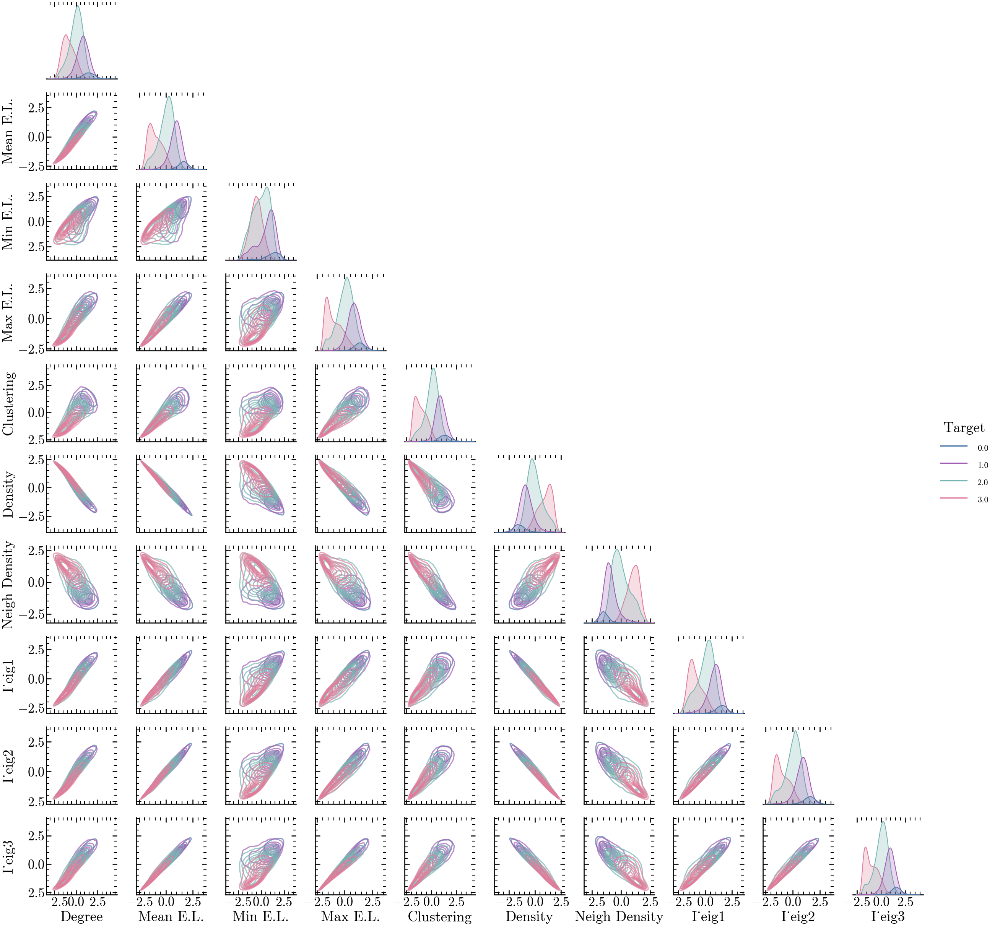

In [23]:
# pairplot of the data

sns.set_context('talk', font_scale=1.5)

# custom_palette = {0:'red', 1:'green', 2:'blue', 3:'yellow'}

# custom_palette = {
#     0: '#1f77b4',    # soft blue
#     1: '#ff7f0e',    # orange
#     2: '#2ca02c',# soft green
#     3: '#d62728'  # muted red
# }

custom_palette = {
    0: '#4c78a8',     # deep teal
    1: '#a05eb5',     # violet
    2: '#76b7b2', # sky teal
    3: '#e17c9a'   # plum pink
}

g = sns.pairplot(
    data2,
    diag_kind='kde',
    kind='kde',
    plot_kws = {'alpha':0.7},
    # plot_kws={'s':10},
    hue='Target',
    corner=True,
    palette=custom_palette
)

for text in g._legend.texts:
    text.set_fontsize(16)

In [29]:
features

,Degree,Mean E.L.,Min E.L.,Max E.L.,Clustering,Density,Neigh Density,I_eig1,I_eig2,I_eig3
Node ID,,,,,,,,,,
0,-1.646452,-1.958968,-1.039620,-2.169511,-2.141763,1.847816,1.788518,-1.732633,-1.901915,-2.129907
1,-1.973694,-2.090995,-1.328754,-2.295426,-2.157240,2.003026,1.878246,-1.859136,-2.072937,-2.243254
2,-1.762285,-1.781132,-1.725716,-1.948146,-1.687259,1.738827,1.394390,-1.497481,-1.729891,-1.918423
3,-1.308880,-1.488860,-1.567460,-1.473780,-1.632677,1.402361,1.655306,-1.323803,-1.393759,-1.451758
4,-1.639701,-1.666248,-1.535331,-1.822256,-1.679555,1.619479,1.215788,-1.564762,-1.693180,-1.692469
...,...,...,...,...,...,...,...,...,...,...
283964,-1.176465,-0.925278,-0.068934,-0.758633,-0.425765,1.026079,0.557484,-1.205841,-0.994359,-0.749496
283965,-0.262586,-0.455145,-0.442890,-0.812406,-0.615455,0.559821,0.186556,-0.256621,-0.585457,-0.560991
283966,0.251364,-0.069469,0.335281,0.212099,-0.418068,-0.007254,0.618307,-0.293719,0.036084,0.025087


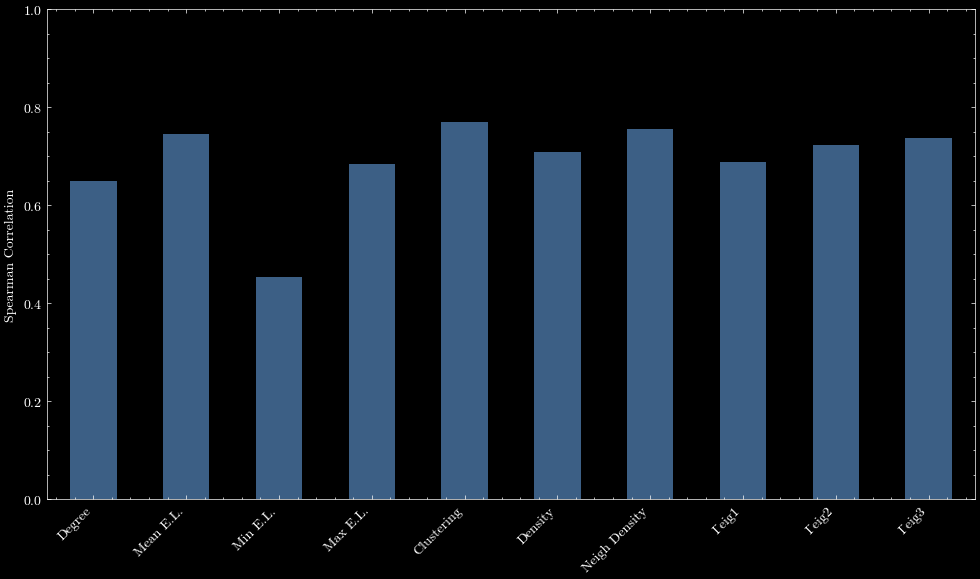

In [30]:
# Quick MI and Spearman's rank
correlations=features.corrwith(targets, axis=0, method='spearman').abs()#.plot.bar()

plt.figure(figsize=(10,6))
correlations.plot.bar(color='#4c78a8', alpha=0.8)
plt.ylabel('Spearman Correlation')
plt.ylim([0,1])
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


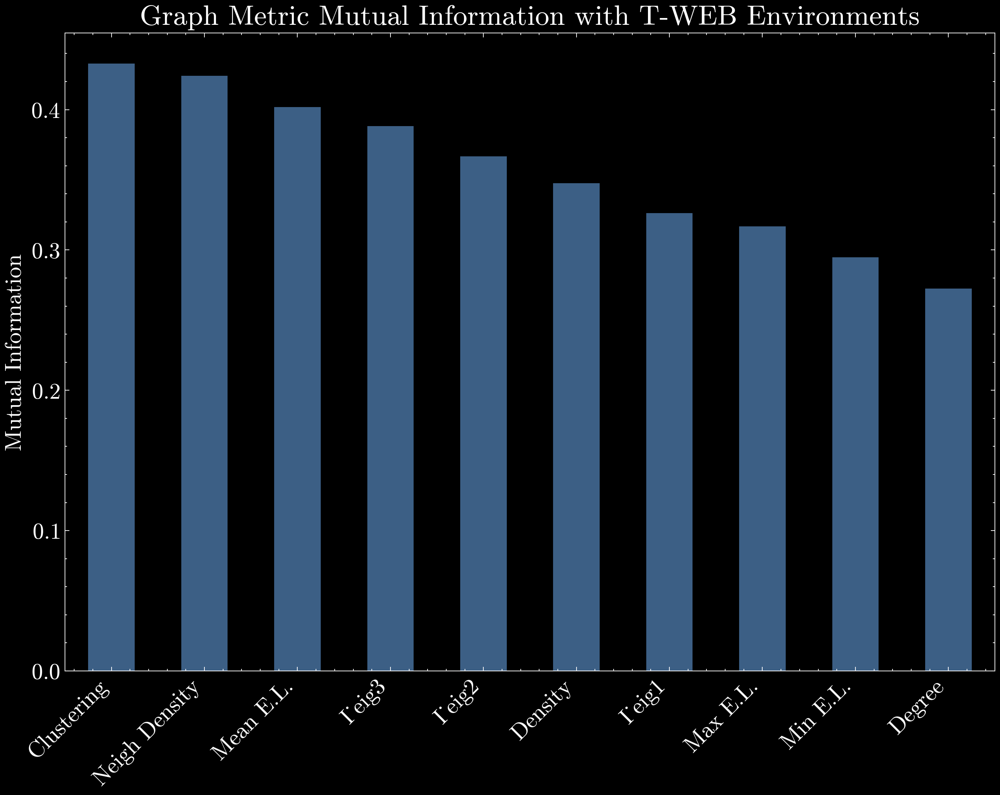

In [31]:
from sklearn.feature_selection import mutual_info_classif

# Calculate mutual information

mi = mutual_info_classif(features, targets, random_state=42)
mi = pd.Series(mi, index=features.columns)
mi = mi.sort_values(ascending=False)
plt.figure(figsize=(10,8), dpi=300)
mi.plot.bar(color='#4c78a8', alpha=0.8)
plt.ylabel('Mutual Information', fontsize=16)
plt.xticks(rotation=45, ha='right', fontsize=16)
plt.title('Graph Metric Mutual Information with T-WEB Environments', fontsize=20)
plt.tick_params(axis='both', labelsize=16)
plt.tight_layout()
plt.savefig('mutual_info_graph_metrics.png', dpi=300, transparent=True)
plt.show()

In [12]:
# PCA and t-SNE

from sklearn.decomposition import PCA

pca = PCA(n_components=4) # we want to reduce the information to 4 dimensions that should represent each cosmic web environment

X_pca = pca.fit_transform(features)

In [13]:
print(pca.explained_variance_)
print(pca.explained_variance_ratio_)
pca.explained_variance_ratio_.cumsum()

[8.50251153 0.64612203 0.44208577 0.22096406]
[0.85024241 0.06461154 0.04420812 0.02209618]


array([0.85024241, 0.91485395, 0.95906207, 0.98115825])

In [14]:
np.shape(X_pca)

data_pca = pd.DataFrame(X_pca, columns=['PC1', 'PC2', 'PC3', 'PC4'], index=features.index)
data_pca['Target'] = targets

data_pca

,PC1,PC2,PC3,PC4,Target
Node ID,,,,,
0,-6.577471,-0.447992,-0.091989,-0.344074,3.0
1,-6.666460,-0.629825,-0.247366,-0.417190,3.0
2,-6.199492,0.240126,0.063149,-0.668116,3.0
3,-5.339156,0.463706,-0.151525,-0.574036,3.0
4,-5.249207,-0.533155,-0.201017,-0.315172,3.0
...,...,...,...,...,...
97228,-1.195375,-0.646669,0.840271,-0.132239,3.0
97229,0.014823,-0.231141,1.207798,0.144421,2.0
97230,-2.698007,-0.911564,-0.312902,-0.171337,2.0


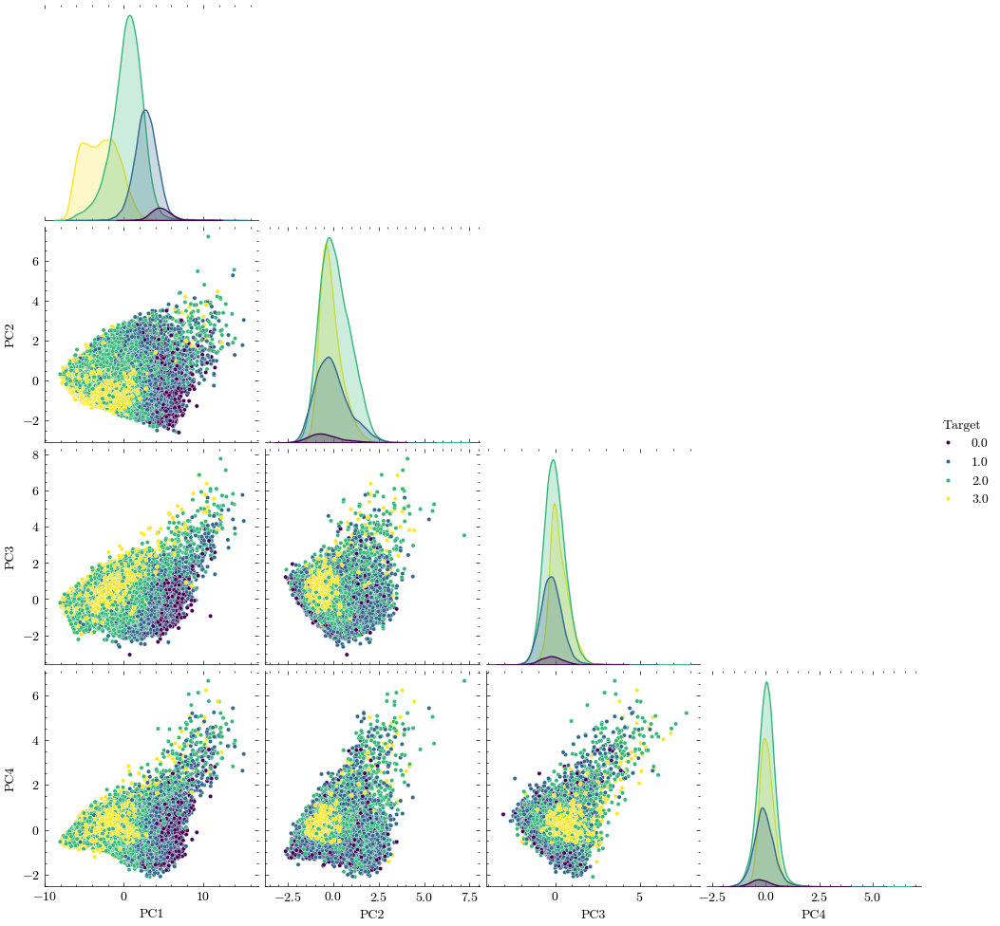

In [15]:
# PCA components as corner plot
import seaborn as sns
sns.pairplot(data_pca, hue='Target', diag_kind='kde', plot_kws={'s': 10}, palette='viridis', corner=True)


In [65]:
from sklearn.metrics import silhouette_score

silhouette_score =  silhouette_score(data_pca.iloc[:,:-1], data_pca.iloc[:,-1])


In [66]:
silhouette_score

0.034808318133467776

In [16]:
import plotly.express as px

fig = px.scatter(x=X_pca[:,0], y=X_pca[:,1], color=data_pca['Target'])
# fig2 = px.scatter(x=X_pca[:,0], y=X_pca[:,2], color=data['Target'])
# fig3 = px.scatter(x=X_pca[:,0], y=X_pca[:,3], color=data['Target'])
# fig4 = px.scatter(x=X_pca[:,1], y=X_pca[:,2], color=data['Target'])
# fig5 = px.scatter(x=X_pca[:,1], y=X_pca[:,3], color=data['Target'])
# fig6 = px.scatter(x=X_pca[:,2], y=X_pca[:,3], color=data['Target'])

fig.update_layout(title='PCA P.C: 1,2')
# fig2.update_layout(title='PCA P.C: 1,3')
# fig3.update_layout(title='PCA P.C: 1,4')
# fig4.update_layout(title='PCA P.C: 2,3')
# fig5.update_layout(title='PCA P.C: 2,4')
# fig6.update_layout(title='PCA P.C: 3,4')

fig.show()


In [17]:
fig = px.scatter_3d(x=X_pca[:,0], y=X_pca[:,1], z=X_pca[:,2], color=data_pca['Target'], opacity=1)
fig.update_traces(marker_size=2)
fig.update_layout(title='PCA 3D')
fig.show()

In [50]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=3)
X_tsne = tsne.fit_transform(features)
tsne.kl_divergence_

2.218355178833008

In [ ]:
tsne

In [51]:
fig = px.scatter(x=X_tsne[:,0], y=X_tsne[:,1],color=data['Target'])
fig.update_layout(title='t-SNE')#, xaxis_title='t-SNE 1', yaxis_title='t-SNE 2', zaxis_title='t-SNE 3')

fig.show()

In [52]:
fig = px.scatter_3d(x=X_tsne[:,0], y=X_tsne[:,1], z= X_tsne[:,2],color=data['Target'])
fig.update_traces(marker_size=2)
fig.update_layout(title='t-SNE')#, xaxis_title='t-SNE 1', yaxis_title='t-SNE 2', zaxis_title='t-SNE 3')

fig.show()

In [32]:
import umap

In [33]:
fit = umap.UMAP(n_neighbors=20, n_components=3)
%time u = fit.fit_transform(features)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


CPU times: user 1h 8min 38s, sys: 29min 11s, total: 1h 37min 49s
Wall time: 2min 49s


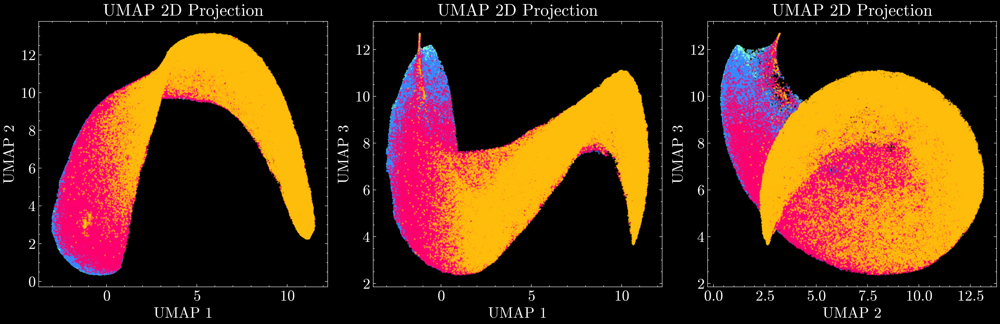

In [39]:
custom_palette = {
    0: '#80ffdb',  # Void — mint-teal neon
    1: '#3a86ff',  # Wall — neon blue
    2: '#ff006e',  # Filament — hot pink
    3: '#ffbe0b'   # Cluster — neon yellow-orange
}

fig, ax = plt.subplots(1, 3, figsize=(15, 5), dpi=300)

for i, (x, y) in enumerate([(0, 1), (0, 2), (1, 2)]):
    for t in sorted(custom_palette.keys()):
        mask = targets == t
        ax[i].scatter(
            u[mask, x], u[mask, y],
            color=custom_palette[t],
            s=1, alpha=0.5, label=f'{t}' if i == 0 else None
        )
    ax[i].set_title('UMAP 2D Projection', fontsize=18)
    ax[i].set_xlabel(f'UMAP {x+1}', fontsize=16)
    ax[i].set_ylabel(f'UMAP {y+1}', fontsize=16)
    ax[i].tick_params(axis='both', labelsize=16)

# handles = [plt.Line2D([0], [0], marker='o', color='w', label=label,
#                       markerfacecolor=color, markersize=8)
#            for label, color in zip(['Void', 'Wall', 'Filament', 'Cluster'], custom_palette.values())]
# ax[0].legend(handles=handles, title='Class', loc='best')

plt.tight_layout()
plt.savefig('umap_projection.png', dpi=300, transparent=True)
plt.show()

In [36]:
features

,Degree,Mean E.L.,Min E.L.,Max E.L.,Clustering,Density,Neigh Density,I_eig1,I_eig2,I_eig3
Node ID,,,,,,,,,,
0,-1.646452,-1.958968,-1.039620,-2.169511,-2.141763,1.847816,1.788518,-1.732633,-1.901915,-2.129907
1,-1.973694,-2.090995,-1.328754,-2.295426,-2.157240,2.003026,1.878246,-1.859136,-2.072937,-2.243254
2,-1.762285,-1.781132,-1.725716,-1.948146,-1.687259,1.738827,1.394390,-1.497481,-1.729891,-1.918423
3,-1.308880,-1.488860,-1.567460,-1.473780,-1.632677,1.402361,1.655306,-1.323803,-1.393759,-1.451758
4,-1.639701,-1.666248,-1.535331,-1.822256,-1.679555,1.619479,1.215788,-1.564762,-1.693180,-1.692469
...,...,...,...,...,...,...,...,...,...,...
283964,-1.176465,-0.925278,-0.068934,-0.758633,-0.425765,1.026079,0.557484,-1.205841,-0.994359,-0.749496
283965,-0.262586,-0.455145,-0.442890,-0.812406,-0.615455,0.559821,0.186556,-0.256621,-0.585457,-0.560991
283966,0.251364,-0.069469,0.335281,0.212099,-0.418068,-0.007254,0.618307,-0.293719,0.036084,0.025087


In [91]:
train_x, test_x, train_y, test_y = train_test_split(features, targets, test_size=0.3, random_state=42, stratify=targets)
valid_x, test_x, valid_y, test_y = train_test_split(test_x, test_y, test_size=0.3, random_state=42, stratify=test_y)

In [90]:
# train_x = torch.tensor(train_x.values, dtype=torch.float32)
# valid_x = torch.tensor(valid_x.values, dtype=torch.float32)
# test_x = torch.tensor(test_x.values, dtype=torch.float32)
# train_y = torch.tensor(train_y.values, dtype=torch.long)
# valid_y = torch.tensor(valid_y.values, dtype=torch.long)
# test_y = torch.tensor(test_y.values, dtype=torch.long) 

# class CustomDataset(Dataset): # Custom dataset class
#     def __init__(self, features, targets, classes):
#         self.features = features
#         self.targets = targets
#         self.classes = classes

#     def __len__(self): # Returns the number of samples in the dataset
#         return len(self.features)
    
#     def __getitem__(self, idx): # Returns the sample at the given index
#         return self.features[idx], self.targets[idx]
# classes = ['Void (0)', 'Wall (1)', 'Filament (2)', 'Cluster (3)']

# train_dataset = CustomDataset(train_x, train_y, classes)
# valid_dataset = CustomDataset(valid_x, valid_y, classes)
# test_dataset = CustomDataset(test_x, test_y, classes)

# train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
# valid_loader = DataLoader(valid_dataset, batch_size=16, shuffle=True)
# test_loader = DataLoader(test_dataset, batch_size=16, shuffle=True)

In [89]:
class mlp(nn.Module):
    def __init__(self, in_channels, out_channels, hidden_channels):
        super(mlp, self).__init__()
        self.layer1 = nn.Linear(in_channels, 10)
        self.layer2 = nn.Linear(10, 10)
        self.layer3 = nn.Linear(10, out_channels)

    def forward(self, x):
        x = F.relu(self.layer1(x))
        x = F.relu(self.layer2(x))
        x = self.layer3(x)
        return x

def train_mlp(model, optimiser, train_loader, val_loader, epochs, criterion):
    train_loss = []
    train_acc = []
    val_loss = []
    val_acc = []

    for epoch in range(epochs):
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0

        for data in train_loader:
            inputs, labels = data
            optimiser.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimiser.step()
            running_loss += loss.item()
            _, predicted = outputs.max(1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

        train_loss.append(running_loss / len(train_loader))
        train_acc.append(100 * correct / total)

        model.eval()
        running_loss = 0.0
        correct = 0
        total = 0

        with torch.no_grad():
            for data in val_loader:
                inputs, labels = data
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                running_loss += loss.item()
                _, predicted = outputs.max(1)
                total += labels.size(0)
                correct += (predicted == labels).sum().item()

        val_loss.append(running_loss / len(val_loader))
        val_acc.append(100 * correct / total)

        if epoch % 10 == 0:
            print(f'Epoch: {epoch}, Train Loss: {train_loss[-1]}, Train Acc: {train_acc[-1]}, Val Loss: {val_loss[-1]}, Val Acc: {val_acc[-1]}')

    return train_loss, train_acc, val_loss, val_acc

def train_model(model, optimiser, train_loader, valid_loader, num_epochs, criterion):
    train_loss = []
    valid_loss = []
    train_accuracy = []
    valid_accuracy = []
    # model.layers.apply(initialise_weights)

    # scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimiser, 'min', factor=0.95, patience=2, cooldown=3) # Dynamically reduce the learning rate when the validation loss plateaus


    for epoch in range(num_epochs):
        model.train()

        running_loss = 0.0
        correct = 0
        total = 0
        for i, data in enumerate(train_loader, 0):
            inputs, labels = data
            optimiser.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimiser.step()
            running_loss += loss.item()
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
        train_loss.append(running_loss/len(train_loader))
        train_accuracy.append(100 * correct / total)
        
        model.eval() # set the model to evaluation mode
        running_loss = 0.0
        correct = 0
        total = 0
        with torch.no_grad():
            for features, labels in valid_loader:
                outputs = model(features)
                loss = criterion(outputs, labels)
                running_loss += loss.item()
                _, predicted = torch.max(outputs, 1)
                total += labels.size(0)
                correct += (predicted == labels).sum().item()
            valid_loss.append(running_loss/len(valid_loader))
            valid_accuracy.append(100 * correct / total)
        model.train() # set the model back to training mode

        # scheduler.step(valid_loss[-1]) 
        if (epoch+1) % 10 == 0:
            print(f'Epoch {epoch+1}/{num_epochs} - Training Loss: {train_loss[-1]:.4f} - Training Accuracy: {train_accuracy[-1]:.2f}% - Validation Loss: {valid_loss[-1]:.4f} - Validation Accuracy: {valid_accuracy[-1]:.2f}% - LR: {optimiser.param_groups[0]["lr"]}')

    return train_loss, valid_loss, train_accuracy, valid_accuracy

def test_model(model, test_loader):
    model.eval()
    correct = 0
    total = 0
    all_preds = []
    all_labels = []
    with torch.no_grad():
        for i, data in enumerate(test_loader, 0):
            inputs, labels = data
            outputs = model(inputs)
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
            all_preds.extend(predicted.tolist())
            all_labels.extend(labels.tolist())
    print(f'Test Accuracy: {100 * correct / total:.2f}%')
    return all_preds, all_labels

In [96]:
from sklearn.utils import class_weight
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader, Dataset

class CustomDataset(Dataset):
    def __init__(self, x, y, classes):
        self.x = torch.tensor(x.values, dtype=torch.float)
        self.y = torch.tensor(y.values, dtype=torch.long)
        self.classes = classes

    def __len__(self):
        return len(self.y)

    def __getitem__(self, idx):
        return self.x[idx], self.y[idx]
    
classes = ['Void (0)', 'Wall (1)', 'Filament (2)', 'Cluster (3)']

train_dataset = CustomDataset(train_x, train_y, classes)
valid_dataset = CustomDataset(valid_x, valid_y, classes)
test_dataset = CustomDataset(test_x, test_y, classes)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
valid_loader = DataLoader(valid_dataset, batch_size=16, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=True)

In [93]:
targets.value_counts()

Target
2.0    128025
3.0     76152
1.0     69019
0.0     10773
Name: count, dtype: int64

In [113]:
NUM_EPOCHS =  90 #@param {type:"integer"}
LR         = 1e-5 #@param {type:"number"}

In [100]:
class_weights

tensor([6.5898, 1.0286, 0.5545, 0.9322])

In [102]:
model = mlp(in_channels=features.shape[1], out_channels=len(classes), hidden_channels=10)
optimiser = optim.Adam(model.parameters(), lr=1e-5)
criterion = nn.CrossEntropyLoss(weight=torch.tensor(class_weights, dtype=torch.float)) #torch.tensor([0.7237, 0.1130, 0.0609, 0.1024]))
train_loss, valid_loss, train_accuracy, valid_accuracy = train_model(model, optimiser, train_loader, valid_loader, 100, criterion)

/tmp/ipykernel_1679447/3423788876.py:3: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  criterion = nn.CrossEntropyLoss(weight=torch.tensor(class_weights, dtype=torch.float)) #torch.tensor([0.7237, 0.1130, 0.0609, 0.1024]))


Epoch 10/100 - Training Loss: 0.7567 - Training Accuracy: 64.07% - Validation Loss: 0.7500 - Validation Accuracy: 64.52% - LR: 1e-05
Epoch 20/100 - Training Loss: 0.7195 - Training Accuracy: 65.26% - Validation Loss: 0.7170 - Validation Accuracy: 65.36% - LR: 1e-05
Epoch 30/100 - Training Loss: 0.7089 - Training Accuracy: 65.79% - Validation Loss: 0.7073 - Validation Accuracy: 65.65% - LR: 1e-05
Epoch 40/100 - Training Loss: 0.7018 - Training Accuracy: 66.02% - Validation Loss: 0.6998 - Validation Accuracy: 66.08% - LR: 1e-05
Epoch 50/100 - Training Loss: 0.6968 - Training Accuracy: 66.22% - Validation Loss: 0.6945 - Validation Accuracy: 66.18% - LR: 1e-05
Epoch 60/100 - Training Loss: 0.6931 - Training Accuracy: 66.42% - Validation Loss: 0.6909 - Validation Accuracy: 66.15% - LR: 1e-05
Epoch 70/100 - Training Loss: 0.6889 - Training Accuracy: 66.47% - Validation Loss: 0.6889 - Validation Accuracy: 66.22% - LR: 1e-05
Epoch 80/100 - Training Loss: 0.6871 - Training Accuracy: 66.54% - Va

In [21]:
# def initialise_weights(m):
#     '''
#     Function to reset the weights of the model
#     '''
#     # using relu so use kaiming initialisation

#     if isinstance(m, nn.Linear):
#         nn.init.kaiming_uniform_(m.weight, nonlinearity='relu')
#         if m.bias is not None:
#             nn.init.zeros_(m.bias)

In [119]:
# class SimpleMLP(nn.Module):
#     def __init__(self, input_size, output_size):
#         super(SimpleMLP, self).__init__()
#         self.layers = nn.Sequential(OrderedDict([
#             ('fc1', nn.Linear(input_size, 10)),
#             ('relu1', nn.ReLU()),
#             ('fc2', nn.Linear(10, 6)),
#             ('relu2', nn.ReLU()), 
#             ('fc3', nn.Linear(6, output_size))])) # for dropout layers we can add nn.Dropout(p=0.5) after an activation function
#         # self.layers = nn.Sequential(OrderedDict([
#         #     ('fc1', nn.Linear(input_size, 30)),
#         #     ('relu1', nn.LeakyReLU()),
#         #     ('fc2', nn.Linear(30, 30)),
#         #     ('relu2', nn.LeakyReLU()),
#         #     ('fc3', nn.Linear(30, 30)),
#         #     ('relu3', nn.LeakyReLU()),
#         #     ('fc4', nn.Linear(30, 30)),
#         #     ('relu4', nn.LeakyReLU()),
#         #     ('fc5', nn.Linear(30, output_size))]))
    
    
#     def forward(self, x):
#         return self.layers(x)

In [120]:
def train_model(model, optimiser, train_loader, valid_loader, num_epochs, criterion):
    train_loss = []
    valid_loss = []
    train_accuracy = []
    valid_accuracy = []
    # model.layers.apply(initialise_weights)

    # scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimiser, 'min', factor=0.95, patience=2, cooldown=3) # Dynamically reduce the learning rate when the validation loss plateaus


    for epoch in range(num_epochs):
        model.train()

        running_loss = 0.0
        correct = 0
        total = 0
        for i, data in enumerate(train_loader, 0):
            inputs, labels = data
            optimiser.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimiser.step()
            running_loss += loss.item()
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
        train_loss.append(running_loss/len(train_loader))
        train_accuracy.append(100 * correct / total)
        
        model.eval() # set the model to evaluation mode
        running_loss = 0.0
        correct = 0
        total = 0
        with torch.no_grad():
            for features, labels in valid_loader:
                outputs = model(features)
                loss = criterion(outputs, labels)
                running_loss += loss.item()
                _, predicted = torch.max(outputs, 1)
                total += labels.size(0)
                correct += (predicted == labels).sum().item()
            valid_loss.append(running_loss/len(valid_loader))
            valid_accuracy.append(100 * correct / total)
        model.train() # set the model back to training mode

        # scheduler.step(valid_loss[-1]) 
        if (epoch+1) % 10 == 0:
            print(f'Epoch {epoch+1}/{num_epochs} - Training Loss: {train_loss[-1]:.4f} - Training Accuracy: {train_accuracy[-1]:.2f}% - Validation Loss: {valid_loss[-1]:.4f} - Validation Accuracy: {valid_accuracy[-1]:.2f}% - LR: {optimiser.param_groups[0]["lr"]}')

    return train_loss, valid_loss, train_accuracy, valid_accuracy

def test_model(model, test_loader):
    model.eval()
    correct = 0
    total = 0
    all_preds = []
    all_labels = []
    with torch.no_grad():
        for i, data in enumerate(test_loader, 0):
            inputs, labels = data
            outputs = model(inputs)
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
            all_preds.extend(predicted)
            all_labels.extend(labels)
    print(f'Test Accuracy: {100 * correct / total:.2f}%')
    return all_preds, all_labels

model = SimpleMLP(input_size=7, output_size=4)
optimiser = optim.Adam(model.parameters(), lr=1e-5)
criterion = nn.CrossEntropyLoss(weight=class_weights)
train_loss, valid_loss, train_accuracy, valid_accuracy = train_model(model, optimiser, train_loader, valid_loader, 100, criterion)
preds, labels = test_model(model, test_loader)

Epoch 10/100 - Training Loss: 0.8383 - Training Accuracy: 59.86% - Validation Loss: 0.8242 - Validation Accuracy: 60.15% - LR: 1e-05
Epoch 20/100 - Training Loss: 0.7429 - Training Accuracy: 64.61% - Validation Loss: 0.7384 - Validation Accuracy: 64.74% - LR: 1e-05
Epoch 30/100 - Training Loss: 0.7190 - Training Accuracy: 65.47% - Validation Loss: 0.7151 - Validation Accuracy: 65.35% - LR: 1e-05
Epoch 40/100 - Training Loss: 0.7097 - Training Accuracy: 65.65% - Validation Loss: 0.7064 - Validation Accuracy: 65.68% - LR: 1e-05
Epoch 50/100 - Training Loss: 0.7033 - Training Accuracy: 65.88% - Validation Loss: 0.7004 - Validation Accuracy: 65.66% - LR: 1e-05
Epoch 60/100 - Training Loss: 0.6987 - Training Accuracy: 66.01% - Validation Loss: 0.6962 - Validation Accuracy: 65.73% - LR: 1e-05
Epoch 70/100 - Training Loss: 0.6954 - Training Accuracy: 66.13% - Validation Loss: 0.6934 - Validation Accuracy: 65.93% - LR: 1e-05
Epoch 80/100 - Training Loss: 0.6932 - Training Accuracy: 66.24% - Va

In [103]:
# normalised confusion matrix
classes = ['Void/Wall (0)', 'Filament (1)', 'Cluster (2)']
cm = confusion_matrix(y_true=labels, y_pred=preds)
cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
plt.figure(figsize=(10,7))
sns.heatmap(cm, annot=True, fmt='.2f',cmap='Blues', xticklabels=classes, yticklabels=classes)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()


NameError: name 'labels' is not defined

In [ ]:
class_weights

In [ ]:
# Plotting training/validation loss and accuracy
fig, ax = plt.subplots(1,2, figsize=(15,5))
ax[0].plot(train_loss, label='Training Loss')
ax[0].plot(valid_loss, label='Validation Loss')
ax[0].set_xlabel('Epoch')
ax[0].set_ylabel('Loss')
ax[0].legend()
ax[1].plot(train_accuracy, label='Training Accuracy')
ax[1].plot(valid_accuracy, label='Validation Accuracy')
ax[1].set_xlabel('Epoch')
ax[1].set_ylabel('Accuracy')
ax[1].legend()
plt.show()

In [13]:
class SimpleGNN(nn.Module):
    """Simple GNN model using the GCNLayer implemented by students

    Args:
        input_dim (int): Dimensionality of the input feature vectors
        output_dim (int): Dimensionality of the output softmax distribution
    """
    def __init__(self, input_dim, output_dim):
        super(SimpleGNN, self).__init__()
        self.gcn_layer1 = GCNConv(input_dim, 15)
        self.gcn_layer2 = GCNConv(15, 15)
        self.gcn_layer3 = GCNConv(15, output_dim)
        # self.gcn_layer4 = GCNConv(10, output_dim)
        self.gcn_dropout = nn.Dropout(p=0.5)

    def forward(self, x, edge_index, edge_weight=None):
        """Forward pass of the GNN model"""
        # x = self.gcn_dropout(x)
        x = F.relu(self.gcn_layer1(x, edge_index, edge_weight=edge_weight))
        # x = self.gcn_dropout(x)
        x = F.relu(self.gcn_layer2(x, edge_index, edge_weight=edge_weight))
        x = self.gcn_dropout(x)
        y_hat = self.gcn_layer3(x, edge_index, edge_weight=edge_weight)
        # y_hat = self.gcn_layer4(x, edge_index, edge_weight=edge_weight)
        return y_hat

In [51]:
class SimpleGAT(nn.Module):
    '''simple GAT model using the GATLayer
    
    Args:
        input_dim (int): Dimensionality of the input feature vectors
        output_dim (int): Dimensionality of the output softmax distribution
        num_heads (int): Number of attention heads
    
    '''
    def __init__(self, input_dim, output_dim, num_heads = 1): # keep a default of 1 head
        super(SimpleGAT, self).__init__()

        hidden_dim = 20  # per-head output size
        total_hidden = hidden_dim * num_heads  # total output size if concat=True


        # self.gat_layer1 = GATv2Conv(input_dim, 15, edge_dim=1, heads=num_heads, concat=True)
        # self.gat_layer2 = GATv2Conv(15, 15, edge_dim=1, heads=num_heads, concat=True)
        # self.gat_layer3 = GATv2Conv(15, output_dim, edge_dim=1, heads=num_heads, concat=False)
        # # self.gat_layer4 = GATv2Conv(10, output_dim)

        self.gat_layer1 = GATv2Conv(input_dim, hidden_dim, edge_dim=1, heads=num_heads, concat=True)
        self.gat_layer2 = GATv2Conv(total_hidden, hidden_dim, edge_dim=1, heads=num_heads, concat=True)
        self.gat_layer3 = GATv2Conv(total_hidden, hidden_dim, edge_dim=1, heads=num_heads, concat=True)
        self.gat_layer4 = GATv2Conv(hidden_dim * num_heads, output_dim, edge_dim=1, heads=1, concat=False)

        self.gat_dropout = nn.Dropout(p=0.1)
        self.norm1 = nn.LayerNorm(total_hidden)
        self.norm2 = nn.LayerNorm(total_hidden)
        self.norm3 = nn.LayerNorm(total_hidden)


    def forward(self, x, edge_index, edge_weight=None, return_attention=False):
        """Forward pass of the GNN model"""

        if return_attention:
            x1, (ei1, attn1) = self.gat_layer1(x, edge_index, edge_attr=edge_weight, return_attention_weights = True)
            x1 = self.gat_dropout(F.relu(self.norm1(x1)))

            x2, (ei2, attn2) = self.gat_layer2(x1, edge_index, edge_attr=edge_weight, return_attention_weights = True)
            x2 = self.gat_dropout(F.relu(self.norm2(x2) + x1))

            x3, (ei3, attn3) = self.gat_layer3(x2, edge_index, edge_attr=edge_weight, return_attention_weights = True)
            x3 = self.gat_dropout(F.relu(self.norm3(x3) + x2))

            y_hat, (ei4, attn4) = self.gat_layer4(x3, edge_index, edge_attr=edge_weight, return_attention_weights = True)


            # y_hat, (ei3, attn3) = self.gat_layer3(x2, edge_index, edge_attr=edge_weight, return_attention_weights = True)

            return y_hat, [(ei1, attn1), (ei2, attn2), (ei3, attn3), (ei4, attn4)]
        
        else:

            x1 = self.gat_dropout(F.relu(self.norm1(self.gat_layer1(x, edge_index, edge_attr=edge_weight))))
            x2 = self.gat_dropout(F.relu(self.norm2(self.gat_layer2(x1, edge_index, edge_attr=edge_weight)) + x1))
            x3 = self.gat_dropout(F.relu(self.norm3(self.gat_layer3(x2, edge_index, edge_attr=edge_weight)) + x2))
            y_hat = self.gat_layer4(x3, edge_index, edge_attr=edge_weight)
        # # x = self.gat_dropout(x)
        # x = F.relu(self.gat_layer1(x, edge_index, edge_attr=edge_weight))
        # # x = self.gat_dropout(x)
        # x = F.relu(self.gat_layer2(x, edge_index, edge_attr=edge_weight))

        # x = F.relu(self.gat_layer3(x, edge_index, edge_attr=edge_weight))

        # y_hat = self.gat_layer4(x, edge_index, edge_attr=edge_weight)
        # # y_hat = self.gat_layer3(x, edge_index, edge_attr=edge_weight)
        # # y_hat = self.gat_layer4(x, edge_index, edge_weight=edge_weight)
        return y_hat

In [21]:
netx = testcat.subhalo_delauany_network(xyzplot=False)

NameError: name 'testcat' is not defined

In [22]:
testcat.cweb_classify(xyzplot=False)

NameError: name 'testcat' is not defined

In [23]:
features

,Degree,Mean E.L.,Min E.L.,Max E.L.,Clustering,Density,Neigh Density,I_eig1,I_eig2,I_eig3
Node ID,,,,,,,,,,
0,-1.646452,-1.958968,-1.039620,-2.169511,-2.141763,1.847816,1.788518,-1.732633,-1.901915,-2.129907
1,-1.973694,-2.090995,-1.328754,-2.295426,-2.157240,2.003026,1.878246,-1.859136,-2.072937,-2.243254
2,-1.762285,-1.781132,-1.725716,-1.948146,-1.687259,1.738827,1.394390,-1.497481,-1.729891,-1.918423
3,-1.308880,-1.488860,-1.567460,-1.473780,-1.632677,1.402361,1.655306,-1.323803,-1.393759,-1.451758
4,-1.639701,-1.666248,-1.535331,-1.822256,-1.679555,1.619479,1.215788,-1.564762,-1.693180,-1.692469
...,...,...,...,...,...,...,...,...,...,...
283964,-1.176465,-0.925278,-0.068934,-0.758633,-0.425765,1.026079,0.557484,-1.205841,-0.994359,-0.749496
283965,-0.262586,-0.455145,-0.442890,-0.812406,-0.615455,0.559821,0.186556,-0.256621,-0.585457,-0.560991
283966,0.251364,-0.069469,0.335281,0.212099,-0.418068,-0.007254,0.618307,-0.293719,0.036084,0.025087


In [24]:
features.cov

<bound method DataFrame.cov of            Degree  Mean E.L.  Min E.L.  Max E.L.  Clustering   Density  \
Node ID                                                                  
0       -1.646452  -1.958968 -1.039620 -2.169511   -2.141763  1.847816   
1       -1.973694  -2.090995 -1.328754 -2.295426   -2.157240  2.003026   
2       -1.762285  -1.781132 -1.725716 -1.948146   -1.687259  1.738827   
3       -1.308880  -1.488860 -1.567460 -1.473780   -1.632677  1.402361   
4       -1.639701  -1.666248 -1.535331 -1.822256   -1.679555  1.619479   
...           ...        ...       ...       ...         ...       ...   
283964  -1.176465  -0.925278 -0.068934 -0.758633   -0.425765  1.026079   
283965  -0.262586  -0.455145 -0.442890 -0.812406   -0.615455  0.559821   
283966   0.251364  -0.069469  0.335281  0.212099   -0.418068 -0.007254   
283967   0.239106  -0.241714 -0.061460  1.414394   -0.805481  0.479491   
283968  -0.263768  -0.389404  0.792963 -0.660101   -0.446659  0.383885   

      

In [25]:
netx_geom = from_networkx(G, group_edge_attrs='all')# netx_geom=from_networkx(netx, group_edge_attrs='all')

/global/homes/d/dkololgi/.local/lib/python3.10/site-packages/torch_geometric/utils/convert.py:278: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at /pytorch/torch/csrc/utils/tensor_new.cpp:254.)
  data_dict[key] = torch.as_tensor(value)


In [32]:
print(netx_geom.num_nodes, netx_geom.num_edges, netx_geom.num_node_features, netx_geom.num_edge_features)


283969 4185110 10 1


In [27]:
netx_geom.x = torch.tensor(features.values, dtype=torch.float32)

In [28]:
netx_geom.y = torch.tensor(targets.values, dtype=torch.long)

In [29]:
netx_geom.y

tensor([3, 3, 3,  ..., 3, 3, 2])

In [30]:
netx_geom.pos

tensor([[6.4539e+01, 7.2060e+01, 2.1788e+02],
        [6.7083e+01, 7.6543e+01, 2.1614e+02],
        [6.5679e+01, 7.2471e+01, 2.1829e+02],
        ...,
        [2.0419e+02, 2.7278e+02, 1.8446e+02],
        [2.2758e-01, 2.1766e+02, 2.2769e+02],
        [6.3663e+01, 1.0823e+02, 2.1974e+02]])

In [31]:
netx_geom.edge_index, np.shape(netx_geom.edge_index)

(tensor([[     0,      0,      0,  ..., 283968, 283968, 283968],
         [   191,    806,    696,  ...,  26061, 228307, 282090]]),
 torch.Size([2, 4185110]))

In [33]:
from torch_geometric.utils import homophily

hmply_1 = homophily(netx_geom.edge_index, netx_geom.y, method='edge')
hmply_2 = homophily(netx_geom.edge_index, netx_geom.y, method='node')
hmply_3 = homophily(netx_geom.edge_index, netx_geom.y, method='edge_insensitive')
print(f'Homophily (edge): {hmply_1:.4f}')
print(f'Homophily (node): {hmply_2:.4f}')
print(f'Homophily (edge insensitive): {hmply_3:.4f}')
# homophily is the tendency of nodes to connect to similar nodes

Homophily (edge): 0.7020
Homophily (node): 0.7383
Homophily (edge insensitive): 0.5192


In [34]:
# from torch_geometric.transforms import RandomNodeSplit

# transform = RandomNodeSplit(split='random', num_train_per_class=5000, num_val=20000, num_test=5000)
# data_pca
# features = data_pca.iloc[:,:-1] # All columns except the last one
# targets = data_pca.iloc[:,-1] # The last column

In [35]:
np.count_nonzero(netx_geom.pos[:,0]>290)

11113

In [36]:
# new train/test/split but f| buffered dataset but with the same indices noting that the graph is the same
buffered_indices_for_mask = np.where((netx_geom.pos[:,0]>10) & (netx_geom.pos[:,0]<290) & (netx_geom.pos[:,1]>10) & (netx_geom.pos[:,1]<290) & (netx_geom.pos[:,2]>10) & (netx_geom.pos[:,2]<290))[0]
anti_buffered_indices_for_mask = np.where((netx_geom.pos[:,0]<10) | (netx_geom.pos[:,0]>290) | (netx_geom.pos[:,1]<10) | (netx_geom.pos[:,1]>290) | (netx_geom.pos[:,2]<10) | (netx_geom.pos[:,2]>290))[0]

In [37]:
print(len(buffered_indices_for_mask), len(anti_buffered_indices_for_mask), len(buffered_indices_for_mask)+len(anti_buffered_indices_for_mask))

229250 54719 283969


In [38]:
# buffered train/test/split

train_x, test_x, train_y, test_y = train_test_split(features.iloc[buffered_indices_for_mask], targets.iloc[buffered_indices_for_mask], test_size=0.3, random_state=42, stratify=targets.iloc[buffered_indices_for_mask])
valid_x, test_x, valid_y, test_y = train_test_split(test_x, test_y, test_size=0.3, random_state=42, stratify=test_y)

# create masks of length num_nodes
train_mask3 = torch.zeros(len(netx_geom.y), dtype=torch.bool)
valid_mask3 = torch.zeros(len(netx_geom.y), dtype=torch.bool)
test_mask3 = torch.zeros(len(netx_geom.y), dtype=torch.bool)

# set indices of train/valid/test to True
train_mask3[train_x.index.values] = True
valid_mask3[valid_x.index.values] = True
test_mask3[test_x.index.values] = True

# # set buffered indices to False
# train_mask3[anti_buffered_indices_for_mask] = False
# valid_mask3[anti_buffered_indices_for_mask] = False
# test_mask3[anti_buffered_indices_for_mask] = False

In [39]:
train_x

,Degree,Mean E.L.,Min E.L.,Max E.L.,Clustering,Density,Neigh Density,I_eig1,I_eig2,I_eig3
Node ID,,,,,,,,,,
31226,-0.150945,-0.442050,-0.025509,0.062011,-0.664293,0.125492,1.060712,0.123544,-0.266765,-0.385663
176757,0.701506,0.664763,0.727235,0.511984,0.797365,-0.708184,-0.801571,0.668809,0.677939,0.668381
186426,0.527648,0.589114,-1.130242,0.287379,0.556487,-0.479660,-0.607638,0.562898,0.473675,0.483052
58988,-1.769094,-1.932378,-1.216988,-1.873733,-1.989583,1.844934,1.883208,-1.814239,-1.897597,-1.920866
40258,-1.746625,-1.848963,-1.284088,-1.955465,-1.839898,1.743076,1.914642,-1.617130,-1.802242,-1.897535
...,...,...,...,...,...,...,...,...,...,...
125119,-0.272151,0.378490,-0.273043,0.530992,1.532751,-0.037037,-1.496325,0.496147,0.225504,0.728710
258656,0.891098,0.702692,1.405877,0.402647,0.436483,-0.720370,-0.240079,0.561337,0.680541,0.442496
179597,-0.278637,-0.334246,-1.162459,0.050291,-0.210856,0.304092,0.005702,-0.127198,-0.295205,-0.269916


In [40]:
# # alternative now with sklearn train_test_split and creating a mask
# train_x, test_x, train_y, test_y = train_test_split(features, targets, test_size=0.3, random_state=42, stratify=targets)
# valid_x, test_x, valid_y, test_y = train_test_split(test_x, test_y, test_size=0.3, random_state=42, stratify=test_y)

# # create masks
# train_mask2 = torch.zeros(len(netx_geom.y), dtype=torch.bool)#len(features)
# valid_mask2 = torch.zeros(len(netx_geom.y), dtype=torch.bool)#len(features)
# test_mask2 = torch.zeros(len(netx_geom.y), dtype=torch.bool)#len(features)

# train_mask2[train_x.index.values] = True
# valid_mask2[valid_x.index.values] = True
# test_mask2[test_x.index.values] = True

In [52]:
# number counts for each class for train/valid/test sets
train_y.value_counts(), valid_y.value_counts(), test_y.value_counts()

(Target
 2.0    72353
 3.0    43598
 1.0    38705
 0.0     5819
 Name: count, dtype: int64,
 Target
 2.0    21706
 3.0    13079
 1.0    11611
 0.0     1746
 Name: count, dtype: int64,
 Target
 2.0    9303
 3.0    5605
 1.0    4977
 0.0     748
 Name: count, dtype: int64)

In [53]:
len(train_x), len(valid_x), len(test_x)

(160475, 48142, 20633)

In [54]:
np.sum([len(train_x), len(valid_x), len(test_x)])

229250

In [55]:
netx_geom.train_mask = train_mask3
netx_geom.val_mask = valid_mask3
netx_geom.test_mask = test_mask3

In [56]:
netx_geom

Data(edge_index=[2, 4185110], pos=[283969, 3], edge_attr=[4185110, 1], x=[283969, 10], y=[283969], train_mask=[283969], val_mask=[283969], test_mask=[283969])

In [57]:
# data = transform(netx_geom) # randomly splitting nodes into test/val/train and storing them as boolean masks in Data() object

In [58]:
netx_geom.x

tensor([[-1.6465, -1.9590, -1.0396,  ..., -1.7326, -1.9019, -2.1299],
        [-1.9737, -2.0910, -1.3288,  ..., -1.8591, -2.0729, -2.2433],
        [-1.7623, -1.7811, -1.7257,  ..., -1.4975, -1.7299, -1.9184],
        ...,
        [ 0.2514, -0.0695,  0.3353,  ..., -0.2937,  0.0361,  0.0251],
        [ 0.2391, -0.2417, -0.0615,  ..., -1.2185, -0.1311,  0.4893],
        [-0.2638, -0.3894,  0.7930,  ..., -0.3022, -0.3570, -0.5248]])

In [59]:
len(netx_geom.y)

283969

In [60]:
# from torch_geometric.loader import NeighborLoader

# # use neighborloader as netx is a huge graph
# train_loader = NeighborLoader(netx_geom, num_neighbors=[-1], batch_size=16, input_nodes=netx_geom.train_mask, shuffle=True)
# val_loader = NeighborLoader(netx_geom, num_neighbors=[-1], batch_size=16, input_nodes=netx_geom.val_mask, shuffle=True)
# test_loader = NeighborLoader(netx_geom, num_neighbors=[-1], batch_size=16, input_nodes=netx_geom.test_mask, shuffle=True)

In [61]:
# # This is for mini-batch training but it is wrong

# def train_gcn(model, train_loader, val_loader, optimiser, criterion, num_epochs):
#     train_loss = []
#     valid_loss = []
#     train_accuracy = []
#     valid_accuracy = []
#     # Training loop

   
#     for epoch in range(num_epochs): 
#         running_loss = 0.0
#         correct = 0
#         total = 0
#         model.train()
#         for batch in train_loader:
#             optimiser.zero_grad()
#             output = model(batch.x, batch.edge_index, batch.edge_attr)
#             loss = criterion(output[batch.train_mask], batch.y[batch.train_mask])
#             loss.backward()
#             optimiser.step()
#             running_loss += loss.item()
#             _, predicted = torch.max(output[batch.train_mask], 1)
#             total += batch.y[batch.train_mask].size(0)
#             correct += (predicted == batch.y[batch.train_mask]).sum().item()
#         train_loss.append(running_loss/len(train_loader))
#         train_accuracy.append(100 * correct / total)

        
#         # Validation loop

#         model.eval()
#         running_loss = 0.0
#         correct = 0
#         total = 0
#         with torch.no_grad():
#             for batch in val_loader:
#                 output = model(batch.x, batch.edge_index, batch.edge_attr)
#                 loss = criterion(output[batch.val_mask], batch.y[batch.val_mask])
#                 running_loss += loss.item()
#                 _, predicted = torch.max(output[batch.val_mask], 1)
#                 total += batch.y[batch.val_mask].size(0)
#                 correct += (predicted == batch.y[batch.val_mask]).sum().item()
#             valid_loss.append(running_loss/len(val_loader))
#             valid_accuracy.append(100 * correct / total)

#         # if (epoch+1) % 10 == 0:
#         print(f'Epoch {epoch+1}/{num_epochs} - Training Loss: {train_loss[-1]:.4f} - Training Accuracy: {train_accuracy[-1]:.2f}% - Validation Loss: {valid_loss[-1]:.4f} - Validation Accuracy: {valid_accuracy[-1]:.2f}% - LR: {optimiser.param_groups[0]["lr"]}')

#     return train_loss, valid_loss, train_accuracy, valid_accuracy

# def test_gcn(model, test_loader):
#     model.eval()
#     all_predicted = []
#     all_labels = []
#     correct = 0
#     total = 0
#     with torch.no_grad():
#         for batch in test_loader:
#             output = model(batch.x, batch.edge_index, batch.edge_attr)
#             _, predicted = torch.max(output[batch.test_mask], 1)
#             all_predicted.extend(predicted)
#             all_labels.extend(batch.y[batch.test_mask])
#             total += batch.y[batch.test_mask].size(0)
#             correct += (predicted == batch.y[batch.test_mask]).sum().item()

#     print(f'Test Accuracy: {100 * correct / total:.2f}%')
#     return all_predicted, all_labels


In [62]:
from torch.cuda.amp import autocast, GradScaler

'''
autocast() automatically chooses the precision for each operation:

Matrix multiplications, convolutions, attention scores → float16 (on tensor cores, for speed)

Operations where float32 is safer (like softmax, loss) → float32

So you don’t need to cast tensors or modules yourself — AMP handles that internally. That’s what makes it automatic mixed precision.
'''

scaler = GradScaler()

/tmp/ipykernel_485985/559476228.py:13: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()


In [63]:
# full-batch training and testing functions

def train_gcn_full(model, data, optimiser, criterion, return_attention=False, num_heads=1):
    '''
    Function to train the GNN model on the full graph
    Args:
        model (nn.Module): GNN model
        data (Data): Data object containing the graph data
        optimiser (torch.optim.Optimizer): Optimiser for the model
        criterion (nn.Module): Loss function
        return_attention (bool): Whether to return the attention weights or not
        num_heads (int): Number of attention heads for GAT model
    Returns:
        loss (float): Training loss
        val_loss (float): Validation loss
        train_acc (float): Training accuracy
        val_acc (float): Validation accuracy
        val_attention_data (list): Attention weights for each layer if return_attention is True
    '''

    # Identify GNN type
    is_gat = isinstance(model, SimpleGAT)

    # Training loop
    model.train()
    optimiser.zero_grad()
    
    with autocast():
        if is_gat and return_attention:
            output, _ = model(data.x, data.edge_index, data.edge_attr, return_attention=True)
        else:
            output = model(data.x, data.edge_index, data.edge_attr)
        loss = criterion(output[data.train_mask], data.y[data.train_mask])
    # output = model(data.x, data.edge_index, data.edge_attr) # remember to pass the edge_attr as we are weighting the edges by their distance

    scaler.scale(loss).backward() # scale the loss for mixed precision training
    scaler.step(optimiser) # update the weights based on the loss
    scaler.update() # update the scaler for mixed precision training

    # loss.backward()
    # optimiser.step() # update the weights based on the loss!

    train_probs = output[data.train_mask]
    _, predicted = torch.max(train_probs, 1)
    correct = (predicted == data.y[data.train_mask]).sum().item()
    total = data.y[data.train_mask].size(0)

    # validation accuracy and loss
    model.eval()
    with torch.no_grad():
        if is_gat and return_attention:
            output, val_attention_data = model(data.x, data.edge_index, data.edge_attr, return_attention=True)
        else:
            output = model(data.x, data.edge_index, data.edge_attr)

        val_loss = criterion(output[data.val_mask], data.y[data.val_mask])
        val_probs = output[data.val_mask]
        _, val_predicted = torch.max(val_probs, 1)
        val_correct = (val_predicted == data.y[data.val_mask]).sum().item()
        val_total = data.y[data.val_mask].size(0)

    model.train()
    val_acc = 100 * val_correct / val_total
    train_acc = 100 * correct / total

    # print(f'Training Loss: {loss.item():.4f} - Training Accuracy: {100 * correct / total:.2f}% - Validation Loss: {val_loss.item():.4f} - Validation Accuracy: {100 * val_correct / val_total:.2f}%')
    return loss, val_loss, train_acc, val_acc, val_attention_data if is_gat and return_attention else None 

def test_gcn_full(model, data, return_attention=False):
    model.eval()
    is_gat = isinstance(model, SimpleGAT)
    
    with torch.no_grad():
        if is_gat and return_attention:
            output, test_attention_data = model(data.x, data.edge_index, data.edge_attr, return_attention=True)
        else:
            output = model(data.x, data.edge_index, data.edge_attr)

        test_probs = F.softmax(output[data.test_mask], dim=1)
        _, predicted = torch.max(test_probs, 1)
        correct = (predicted == data.y[data.test_mask]).sum().item()

        
        total = data.y[data.test_mask].size(0)
    print(f'Test Accuracy: {100 * correct / total:.2f}%')
    
    return predicted, data.y[data.test_mask], test_probs, test_attention_data if is_gat and return_attention else None


In [64]:
# defining class weights

void_weight = targets[targets==0].shape[0]/targets.shape[0]
wall_weight = targets[targets==1].shape[0]/targets.shape[0]
filament_weight = targets[targets==2].shape[0]/targets.shape[0]
cluster_weight = targets[targets==3].shape[0]/targets.shape[0]

class_weights = torch.tensor([1/void_weight, 1/wall_weight, 1/filament_weight, 1/cluster_weight])
print(class_weights/sum(class_weights))
# class_weights = torch.tensor([12.8190725 ,  1.21606047 , 0.51950871, 0.85123178])
class_weights = class_weights/sum(class_weights)

# voidwall_weight = targets[targets==0].shape[0]/targets.shape[0]
# # wall_weight = targets[targets==1].shape[0]/targets.shape[0]
# filament_weight = targets[targets==1].shape[0]/targets.shape[0]
# cluster_weight = targets[targets==2].shape[0]/targets.shape[0]

# class_weights = torch.tensor([1/voidwall_weight, 1/filament_weight, 1/cluster_weight])
# print(class_weights/sum(class_weights))
# # class_weights = torch.tensor([12.8190725 ,  1.21606047 , 0.51950871, 0.85123178])
# class_weights = class_weights/sum(class_weights)


tensor([0.7237, 0.1130, 0.0609, 0.1024])


In [65]:
targets

Node ID
0         3.0
1         3.0
2         3.0
3         3.0
4         3.0
         ... 
283964    3.0
283965    3.0
283966    3.0
283967    3.0
283968    2.0
Name: Target, Length: 283969, dtype: float64

In [66]:
class_weights = compute_class_weight(class_weight ='balanced', classes=np.unique(targets), y=targets)
class_weights = torch.tensor(class_weights, dtype=torch.float32)
class_weights

tensor([6.5898, 1.0286, 0.5545, 0.9322])

In [67]:
print(torch.cuda.device_count())
print(torch.cuda.get_device_name())
print(torch.cuda.get_device_properties(torch.cuda.device(0)))

1
NVIDIA A100-SXM4-40GB
_CudaDeviceProperties(name='NVIDIA A100-SXM4-40GB', major=8, minor=0, total_memory=40326MB, multi_processor_count=108, uuid=0c84e9ea-eb03-d0fd-94b6-c87fa7f2aa07, L2_cache_size=40MB)


In [68]:
# Enabling GPU support
# Check if CUDA is available and set the device accordingly
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using device: {device}')

torch.backends.cudnn.benchmark = True
torch.backends.cudnn.deterministic = False

Using device: cuda


In [77]:
# model = SimpleGNN(10, 4)
# optimiser = optim.Adam(model.parameters(), lr=0.3e-2)
# criterion = nn.CrossEntropyLoss(weight=class_weights)#torch.tensor([0.63, 0.17, 0.09, 0.11]))

model = SimpleGNN(10, 4).to(device)
netx_geom = netx_geom.to(device)
optimiser = optim.Adam(model.parameters(), lr= 3e-3) #0.3e-2
criterion = nn.CrossEntropyLoss(weight=class_weights.to(device))

num_epochs = 6000
full_train_loss = []
full_val_loss = []
full_train_acc = []
full_val_acc = []
for epoch in range(num_epochs):
    train_loss, val_loss,train_acc,val_acc,_ = train_gcn_full(model, netx_geom, optimiser, criterion)
    full_train_loss.append(train_loss.item())
    full_val_loss.append(val_loss.item())
    full_train_acc.append(train_acc)
    full_val_acc.append(val_acc)
    if (epoch+1) % 200 == 0:
        print(f'Epoch {epoch+1}/{num_epochs} - Training Loss: {train_loss:.4f} - Validation Loss: {val_loss:.4f} - Training Accuracy: {train_acc:.2f}% - Validation Accuracy: {val_acc:.2f}%')

full_predicted, full_labels, full_probs, _ = test_gcn_full(model, netx_geom)

/tmp/ipykernel_1348627/2734133257.py:28: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Epoch 200/6000 - Training Loss: 0.7119 - Validation Loss: 0.7030 - Training Accuracy: 63.58% - Validation Accuracy: 63.54%
Epoch 400/6000 - Training Loss: 0.6877 - Validation Loss: 0.6808 - Training Accuracy: 65.31% - Validation Accuracy: 65.27%
Epoch 600/6000 - Training Loss: 0.6730 - Validation Loss: 0.6669 - Training Accuracy: 66.80% - Validation Accuracy: 66.56%
Epoch 800/6000 - Training Loss: 0.6651 - Validation Loss: 0.6577 - Training Accuracy: 67.27% - Validation Accuracy: 67.44%
Epoch 1000/6000 - Training Loss: 0.6589 - Validation Loss: 0.6522 - Training Accuracy: 67.66% - Validation Accuracy: 67.96%
Epoch 1200/6000 - Training Loss: 0.6543 - Validation Loss: 0.6480 - Training Accuracy: 68.21% - Validation Accuracy: 68.48%
Epoch 1400/6000 - Training Loss: 0.6522 - Validation Loss: 0.6443 - Training Accuracy: 68.25% - Validation Accuracy: 68.55%
Epoch 1600/6000 - Training Loss: 0.6502 - Validation Loss: 0.6416 - Training Accuracy: 68.38% - Validation Accuracy: 68.88%
Epoch 1800/6

In [69]:
# Learning rate scheduler
from torch.optim.lr_scheduler import ReduceLROnPlateau

In [71]:
model = SimpleGAT(10, 4, num_heads=4).to(device)
netx_geom = netx_geom.to(device)
optimiser = optim.Adam(model.parameters(), lr= 3e-3) #0.3e-2

# scheduler = ReduceLROnPlateau(optimiser, mode='min', factor=0.5, patience=100, verbose=True, threshold=1e-4, cooldown=10)

scheduler = ReduceLROnPlateau(
    optimiser,
    mode='min',
    factor=0.7,            # decay slowly
    patience=200,          # wait longer
    threshold=1.5e-3,        # ignore tiny changes. 0.1% change to count as an improvement as mode is 'rel'
    threshold_mode='rel',  # relative change
    cooldown=50,           # allow some recovery time
    min_lr=5e-4,           # avoid freezing
)

criterion = nn.CrossEntropyLoss(weight=class_weights.to(device))#torch.tensor([0.63, 0.17, 0.09, 0.11]))
num_epochs = 15000
full_train_loss = []
full_val_loss = []
full_train_acc = []
full_val_acc = []

# Track the initial learning rate
last_lr = optimiser.param_groups[0]['lr']

for epoch in range(num_epochs):
    train_loss, val_loss,train_acc,val_acc, _ = train_gcn_full(model, netx_geom, optimiser, criterion, return_attention=False)
    full_train_loss.append(train_loss.item())
    full_val_loss.append(val_loss.item())
    full_train_acc.append(train_acc)
    full_val_acc.append(val_acc)

    scheduler.step(val_loss.item()) # reduce the learning rate if the validation loss does not improve

    # Check for learning rate change
    current_lr = optimiser.param_groups[0]['lr']
    if current_lr != last_lr:
        print(f"[Epoch {epoch+1}] Learning rate changed from {last_lr:.6e} → {current_lr:.6e}")
        last_lr = current_lr

    if (epoch+1) % 100 == 0:
        print(f"Allocated: {torch.cuda.memory_allocated() / 1e9:.2f} GB | Reserved: {torch.cuda.memory_reserved() / 1e9:.2f} GB")
        print(f'Epoch {epoch+1}/{num_epochs} - Training Loss: {train_loss:.4f} - Validation Loss: {val_loss:.4f} - Training Accuracy: {train_acc:.2f}% - Validation Accuracy: {val_acc:.2f}%')

full_predicted, full_labels, full_probs, attn_layers = test_gcn_full(model, netx_geom, return_attention=True)

/tmp/ipykernel_485985/2734133257.py:28: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Allocated: 0.12 GB | Reserved: 14.81 GB
Epoch 100/15000 - Training Loss: 0.5849 - Validation Loss: 0.5807 - Training Accuracy: 70.20% - Validation Accuracy: 71.70%
Allocated: 0.12 GB | Reserved: 14.81 GB
Epoch 200/15000 - Training Loss: 0.5216 - Validation Loss: 0.5171 - Training Accuracy: 73.74% - Validation Accuracy: 74.67%
Allocated: 0.12 GB | Reserved: 14.81 GB
Epoch 300/15000 - Training Loss: 0.4919 - Validation Loss: 0.4915 - Training Accuracy: 75.05% - Validation Accuracy: 74.56%
Allocated: 0.12 GB | Reserved: 14.81 GB
Epoch 400/15000 - Training Loss: 0.4797 - Validation Loss: 0.4778 - Training Accuracy: 75.03% - Validation Accuracy: 76.65%
Allocated: 0.12 GB | Reserved: 14.81 GB
Epoch 500/15000 - Training Loss: 0.4687 - Validation Loss: 0.4710 - Training Accuracy: 76.42% - Validation Accuracy: 75.32%
Allocated: 0.12 GB | Reserved: 14.81 GB
Epoch 600/15000 - Training Loss: 0.4620 - Validation Loss: 0.4625 - Training Accuracy: 77.23% - Validation Accuracy: 75.97%
Allocated: 0.12 

In [72]:
# Save GAT+ Model for later use
torch.save(model.state_dict(), 'trained_gat_simulation.pth')
torch.save({'model_state_dict': model.state_dict(),
            'optimiser_state_dict': optimiser.state_dict(),
            'scheduler_state_dict': scheduler.state_dict(),
           }, 'full_training_checkpoint.pth')

In [73]:
# full_predicted, full_labels, full_probs = test_gcn_full(model, netx_geom)

In [74]:
out_layer_index3, attn_weights3 = attn_layers[-3]

In [75]:
out_layer_index3[0]
#), np.shape(attn_weights3)

tensor([     0,      0,      0,  ..., 283966, 283967, 283968], device='cuda:0')

In [76]:
np.shape(out_layer_index3), np.shape(attn_weights3), np.shape(netx_geom.edge_index), np.shape(netx_geom.edge_attr)

(torch.Size([2, 4469079]),
 torch.Size([4469079, 4]),
 torch.Size([2, 4185110]),
 torch.Size([4185110, 1]))

In [77]:
np.shape(attn_weights3)

torch.Size([4469079, 4])

In [78]:
# import plotly.graph_objects as go
# import webbrowser
# import os

# def plot_3d_attention_edges(edge_index, attn_weights, positions, threshold=0.0, title="GATv2 3D Attention Graph", scale=1.0):
#     """
#     Plot a 3D graph with edges colored by attention weight using Plotly.
    
#     Args:
#         edge_index (Tensor): [2, num_edges] tensor of edge indices.
#         attn_weights (Tensor): [num_edges] or [num_edges, num_heads] tensor.
#         positions (Tensor or ndarray): [num_nodes, 3] array of 3D positions.
#         threshold (float): Optional threshold (0–1) to filter out low-attention edges.
#         title (str): Title of the plot.
#         scale (float): Optional scaling factor for attention thickness.
#     """
#     edge_index = edge_index.cpu().numpy()
#     if attn_weights.ndim == 2:
#         attn_weights = attn_weights.mean(dim=1)  # average over heads
#     attn_weights = attn_weights.cpu().numpy()

#     # Normalize attention weights to [0,1]
#     attn_weights_norm = (attn_weights - attn_weights.min()) / (attn_weights.max() - attn_weights.min() + 1e-8)
    
#     # Apply threshold
#     mask = attn_weights_norm >= threshold
#     edges = edge_index[:, mask]
#     weights = attn_weights_norm[mask]

#     # Node positions
#     pos = positions.cpu().numpy() if isinstance(positions, torch.Tensor) else positions

#     # Corrected edge_lines
#     x_lines = []
#     y_lines = []
#     z_lines = []
#     edge_colors = []

#     for i in range(edges.shape[1]):
#         src, tgt = edges[:, i]
#         x_lines += [pos[src][0], pos[tgt][0], None]
#         y_lines += [pos[src][1], pos[tgt][1], None]
#         z_lines += [pos[src][2], pos[tgt][2], None]
#         edge_colors.append(weights[i])  # one color per edge

#     edge_trace = go.Scatter3d(
#         x=x_lines,
#         y=y_lines,
#         z=z_lines,
#         mode='lines',
#         line=dict(
#             color=edge_colors,
#             colorscale='Viridis',
#             cmin=0,
#             cmax=1,
#             width=scale,
#         ),
#         hoverinfo='none'
#     )

#     # Build node trace (optional)
#     node_trace = go.Scatter3d(
#         x=pos[:, 0],
#         y=pos[:, 1],
#         z=pos[:, 2],
#         mode='markers',
#         marker=dict(
#             size=2,
#             color='pink',
#             opacity=0.6
#         ),
#         hoverinfo='none'
#     )

#     # Final layout and rendering
#     fig = go.Figure(data=[edge_trace, node_trace])
#     fig.update_layout(
#         title=title,
#         showlegend=False,
#         scene=dict(
#             xaxis_title='X',
#             yaxis_title='Y',
#             zaxis_title='Z',
#             aspectmode='data',
#         ),
#         margin=dict(l=0, r=0, t=40, b=0)
#     )

#     # Save and open in browser
#     fig_path = "gat_attention_3d.html"
#     fig.write_html(fig_path, auto_open=True)

In [79]:
# plot_3d_attention_edges(out_layer_index3, attn_weights3, netx_geom.pos, threshold=0.2, title="GATv2 Attention on TNG300")

In [80]:
test.data.index.values[test_mask3]

array([     2,     56,     61, ..., 283929, 283939, 283962])

In [81]:
type(full_labels)

torch.Tensor

In [82]:
# # Save the DataFrame to a CSV file
# import pandas as pd
# import numpy as np
# name = 'gat_4H_10_9_test_out_cuda.csv'
# galaxyIDs = test.data.index.values[test_mask3]
# # full_labels = full_labels.cpu()
# # full_predicted = full_predicted.cpu()
# pd.DataFrame({'Labels': full_labels, 'Predictions': full_predicted}, index=galaxyIDs).to_csv(name, index=True)

In [83]:
test.data['Target'].value_counts()

Target
2.0    128025
3.0     76152
1.0     69019
0.0     10773
Name: count, dtype: int64

In [84]:
# input_dim = 7#data.num_node_features
# output_dim = 4#data.num_classes
# model = SimpleGNN(input_dim, output_dim)
# optimiser = optim.Adam(model.parameters(), lr=1e-4)
# criterion = nn.CrossEntropyLoss()#weight=class_weights)
# train_loss, valid_loss, train_accuracy, valid_accuracy = train_gcn(model, train_loader, val_loader, optimiser, criterion, 40)
# # test_gcn(model, test_loader)

In [85]:
classes = ['Void (0)', 'Wall (1)', 'Filament (2)', 'Cluster (3)']


In [86]:
# predicted, labels = test_gcn(model, test_loader)

In [87]:
void_post = full_probs.detach().cpu().numpy()[:,0]
wall_post = full_probs.detach().cpu().numpy()[:,1]
filament_post = full_probs.detach().cpu().numpy()[:,2]
cluster_post = full_probs.detach().cpu().numpy()[:,3]

In [88]:
n_bins = 10


prob_range = (0, 1) # should always be between 0 and 1
# for each class create probability bins and count the number of samples in each bin but we need to know which bin each sample belongs to. N = number in each probability bin and n = number of galaxies in each bin that are truely that class
void_hist, void_bins = np.histogram(void_post, bins=n_bins, range=prob_range)
wall_hist, wall_bins = np.histogram(wall_post, bins=n_bins, range=prob_range)
filament_hist, filament_bins = np.histogram(filament_post, bins=n_bins, range=prob_range)
cluster_hist, cluster_bins = np.histogram(cluster_post, bins=n_bins, range=prob_range)

# how many galaxies are classified as each class in each probability bin
void_correct = np.histogram(void_post[(full_labels.cpu()==0) ], bins=void_bins, range=prob_range)[0]
wall_correct = np.histogram(wall_post[(full_labels.cpu()==1) ], bins=wall_bins, range=prob_range)[0]
filament_correct = np.histogram(filament_post[(full_labels.cpu()==2) ], bins=filament_bins, range=prob_range)[0]
cluster_correct = np.histogram(cluster_post[(full_labels.cpu()==3) ], bins=cluster_bins, range=prob_range)[0]

In [89]:
# empirical_probs = np.array([void_correct/void_hist, wall_correct/wall_hist, filament_correct/filament_hist, cluster_correct/cluster_hist]) # no. of classes x no. of probability bins
void_empirical_probs = np.array(void_correct/void_hist)
wall_empirical_probs = np.array(wall_correct/wall_hist)
filament_empirical_probs = np.array(filament_correct/filament_hist)
cluster_empirical_probs = np.array(cluster_correct/cluster_hist)

# which bin each sample belongs to for each class posterior
void_bin_indices = np.digitize(void_post, void_bins, right=True)
wall_bin_indices = np.digitize(wall_post, wall_bins, right=True)
filament_bin_indices = np.digitize(filament_post, filament_bins, right=True)
cluster_bin_indices = np.digitize(cluster_post, cluster_bins, right=True)

# for each sample find the maximum probability bin and posterior class 
# no. of classes x no. of samples
# bin_indices = np.array([void_bin_indices, wall_bin_indices, filament_bin_indices, cluster_bin_indices])

# empirical_probs2 = np.empty(len(void_post))
# for n in range(len(void_post)): # for each sample
#     for i in range(4): # for each class
#         for j in range(n_bins): # for each bin
#             empirical_probs2[n] = empirical_probs[:,bin_indices[i,n]-1]

# bin_indices[:,0]

# void_empirical_probs = empirical_probs[:,void_bin_indices-1]
# wall_empirical_probs = empirical_probs[:,wall_bin_indices-1]
# filament_empirical_probs = empirical_probs[:,filament_bin_indices-1]
# cluster_empirical_probs = empirical_probs[:,cluster_bin_indices-1]

#empirical probabilities for each galaxy <n_i>/N from the probability bins
empirical_probs = np.array([void_empirical_probs[void_bin_indices-1], wall_empirical_probs[wall_bin_indices-1], filament_empirical_probs[filament_bin_indices-1], cluster_empirical_probs[cluster_bin_indices-1]])

In [90]:
A_max = empirical_probs.max(axis=0).mean()
A_max

0.8744732961343794

In [91]:
# assigning error bars by modelling counts as a binomial distribution
n_bi = np.array([void_hist, wall_hist, filament_hist, cluster_hist])
k_bi = np.array([void_correct, wall_correct, filament_correct, cluster_correct])
p_bi = np.array([void_empirical_probs, wall_empirical_probs, filament_empirical_probs, cluster_empirical_probs])
error_bi = np.sqrt(p_bi*(1-p_bi)/n_bi)
error_bi.shape

(4, 10)

In [92]:
plt.style.use(['science','no-latex'])

Text(0, 0.5, 'Expected $P(k=3 \\mid x) = \\frac{n_{cluster}}{N_{bin}}$')

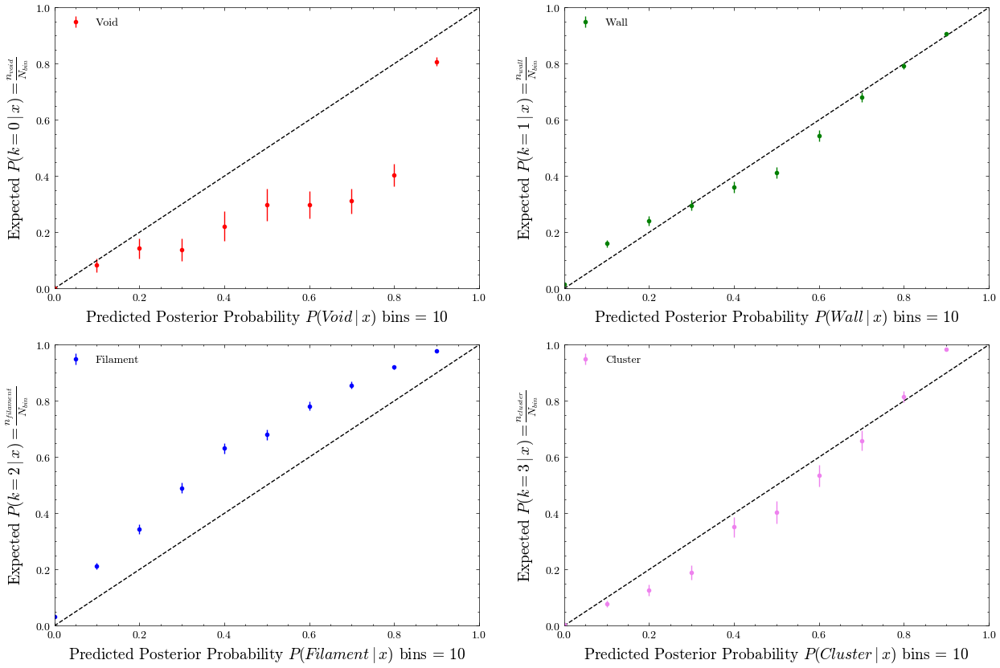

In [93]:
fig, ax = plt.subplots(2,2, figsize=(15,10))
ax[0,0].errorbar(void_bins[:-1], void_correct/void_hist, yerr=error_bi[0], label='Void', color='red', marker='.', linestyle='None')
ax[0,1].errorbar(wall_bins[:-1], wall_correct/wall_hist, yerr=error_bi[1], label='Wall', color='green', marker='.', linestyle='None')
ax[1,0].errorbar(filament_bins[:-1], filament_correct/filament_hist, yerr=error_bi[2], label='Filament', color='blue', marker='.', linestyle='None')
ax[1,1].errorbar(cluster_bins[:-1], cluster_correct/cluster_hist, yerr=error_bi[3], label='Cluster', color='violet', marker='.', linestyle='None')

ax[0,0].axline([0,0], slope=1, ls='--', color='black')
ax[0,1].axline([0,0], slope=1, ls='--', color='black')
ax[1,0].axline([0,0], slope=1, ls='--', color='black')
ax[1,1].axline([0,0], slope=1, ls='--', color='black')

ax[0,0].set_ylim(0,1)
ax[0,1].set_ylim(0,1)
ax[1,0].set_ylim(0,1)
ax[1,1].set_ylim(0,1)

ax[0,0].set_xlim(0,1)
ax[0,1].set_xlim(0,1)
ax[1,0].set_xlim(0,1)
ax[1,1].set_xlim(0,1)

ax[0,0].legend(loc='upper left')
ax[0,1].legend(loc='upper left')
ax[1,0].legend(loc='upper left')
ax[1,1].legend(loc='upper left')

ax[0,1].set_xlabel(rf'Predicted Posterior Probability $P(Wall \mid x)$ bins = {n_bins}', fontsize=14)
ax[0,0].set_xlabel(rf'Predicted Posterior Probability $P(Void \mid x)$ bins = {n_bins}', fontsize=14)
ax[1,0].set_xlabel(rf'Predicted Posterior Probability $P(Filament \mid x)$ bins = {n_bins}', fontsize=14)
ax[1,1].set_xlabel(rf'Predicted Posterior Probability $P(Cluster \mid x)$ bins = {n_bins}', fontsize=14)

# set to latex
plt.rcParams["text.usetex"] = True

ax[0,0].set_ylabel(r'Expected $P(k=0 \mid x) = \frac{n_{void}}{N_{bin}}$', fontsize=14)
ax[0,1].set_ylabel(r'Expected $P(k=1 \mid x) = \frac{n_{wall}}{N_{bin}}$', fontsize=14)
ax[1,0].set_ylabel(r'Expected $P(k=2 \mid x) = \frac{n_{filament}}{N_{bin}}$', fontsize=14)
ax[1,1].set_ylabel(r'Expected $P(k=3 \mid x) = \frac{n_{cluster}}{N_{bin}}$', fontsize=14)


In [94]:
# maxprobs = np.max(full_probs.detach().numpy(), axis=1)

# Amax = maxprobs.sum()/len(maxprobs)
# print(Amax)

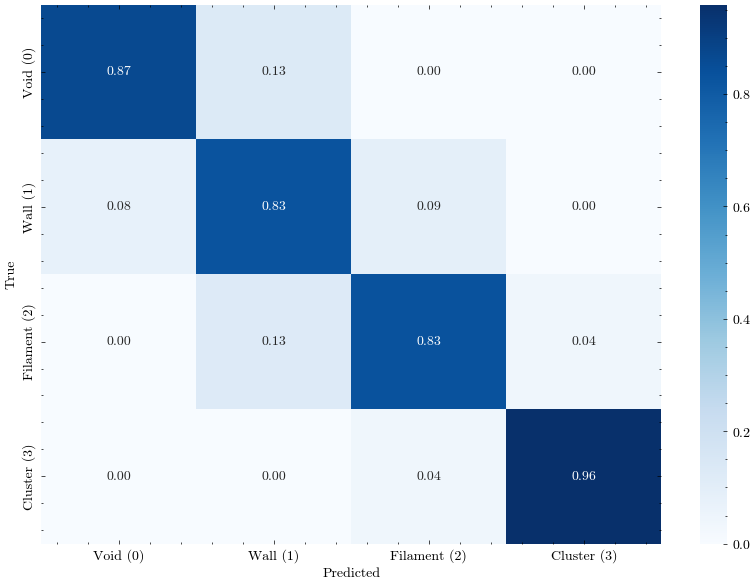

In [95]:
# normalised confusion matrix
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

plt.style.use(['science','no-latex'])

cm = confusion_matrix(full_labels.cpu(), full_predicted.cpu())
cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
plt.figure(figsize=(10,7))
sns.heatmap(cm, annot=True, fmt='.2f',cmap='Blues', xticklabels=classes, yticklabels=classes)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

In [96]:
cm = confusion_matrix(full_labels.cpu(), full_predicted.cpu())
cm

array([[ 648,   98,    2,    0],
       [ 383, 4136,  458,    0],
       [   9, 1178, 7741,  375],
       [   0,    2,  228, 5375]])

In [97]:
classes = ['Void (0)', 'Wall (1)', 'Filament (2)', 'Cluster (3)']


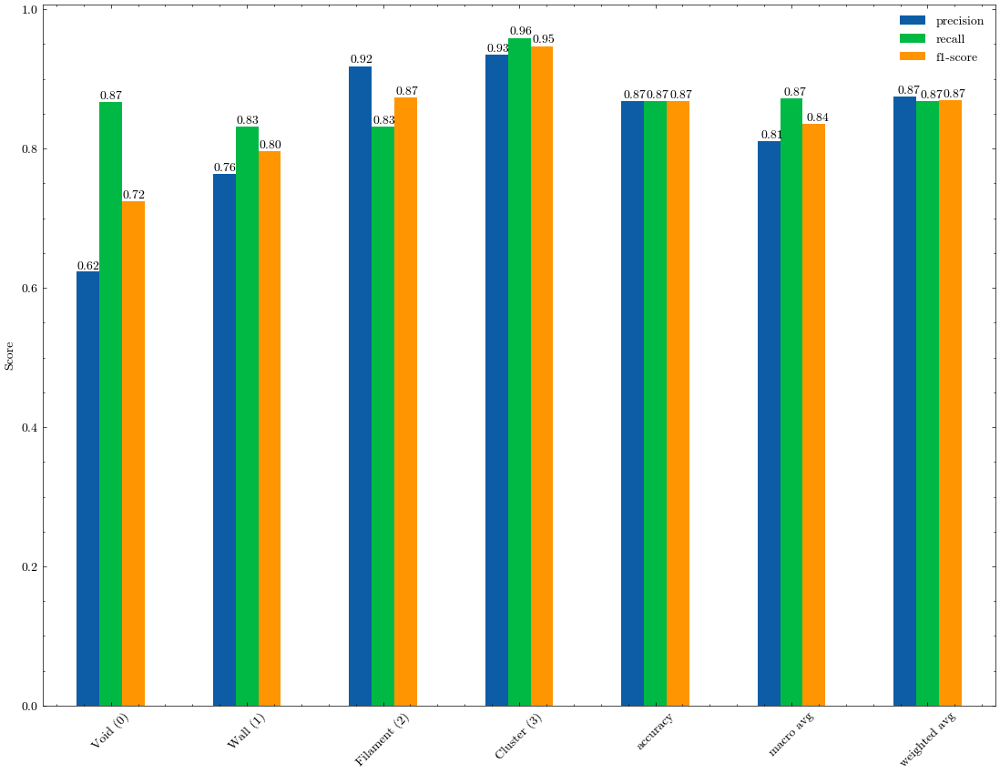

In [98]:
from sklearn.metrics import classification_report

stats=classification_report(full_labels.cpu(), full_predicted.cpu(), target_names=classes, output_dict=True)

stats_df = pd.DataFrame(stats).transpose().drop(columns=['support'])
    
    #.drop(columns=['accuracy', 'macro avg', 'weighted avg']).T.drop(columns=['support'])

# precision recall f1 with labels on the bars of the bar plot of the scores
fig, ax = plt.subplots(figsize=(13.5,10))
stats_df.plot(kind='bar', ax=ax)
for p in ax.patches:
    ax.annotate(f'{p.get_height():.2f}', (p.get_x() * 1.005, p.get_height() * 1.005))
ax.set_ylabel('Score')
ax.legend()
ax.tick_params(axis='x', rotation=45)
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


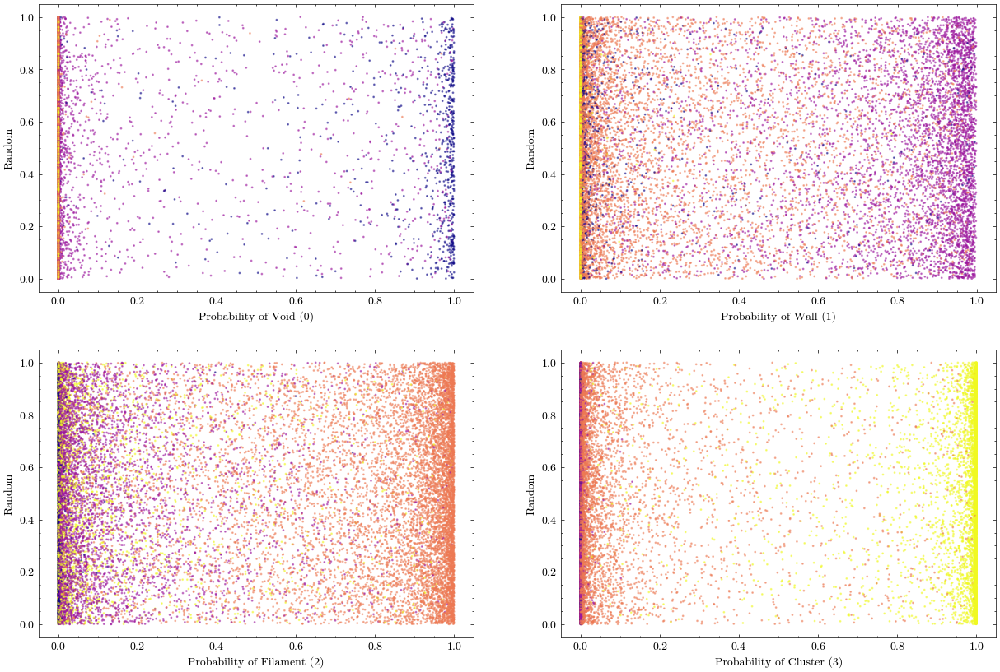

In [99]:
# probability on x axis for each class and random y position for each galaxy but galaxy coloured with either the true or predicted class
colors = ['red', 'green', 'blue', 'violet']
fig, ax = plt.subplots(2,2, figsize=(15,10))

for i in range(4):
    ax[i//2, i%2].scatter(full_probs.detach().cpu()[:,i], np.random.rand(len(full_probs.detach().cpu())), cmap='plasma', s=1, c=full_labels.cpu(), alpha=0.5)
    ax[i//2, i%2].set_xlabel(f'Probability of {classes[i]}')
    ax[i//2, i%2].set_ylabel('Random')
plt.legend()
plt.show()



In [100]:
np.unique(full_labels.cpu())

array([0, 1, 2, 3])

In [101]:
full_probs.cpu().detach().numpy()

array([[7.8138133e-16, 9.4151794e-08, 9.3092956e-03, 9.9069059e-01],
       [6.1911759e-14, 1.1850950e-08, 4.1319709e-05, 9.9995863e-01],
       [2.8827853e-16, 6.7466051e-09, 5.7418358e-05, 9.9994254e-01],
       ...,
       [2.6588827e-24, 1.2936604e-07, 3.8295954e-01, 6.1704028e-01],
       [1.9677230e-19, 8.5225438e-05, 8.4603763e-01, 1.5387709e-01],
       [3.8166341e-24, 4.4675495e-08, 4.1434612e-02, 9.5856541e-01]],
      dtype=float32)

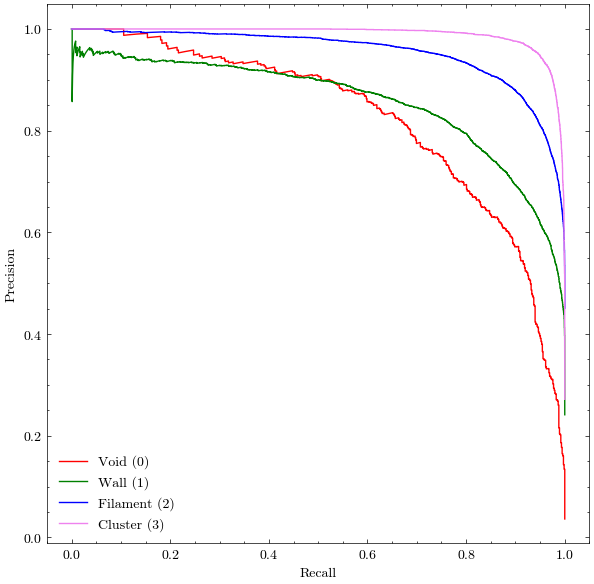

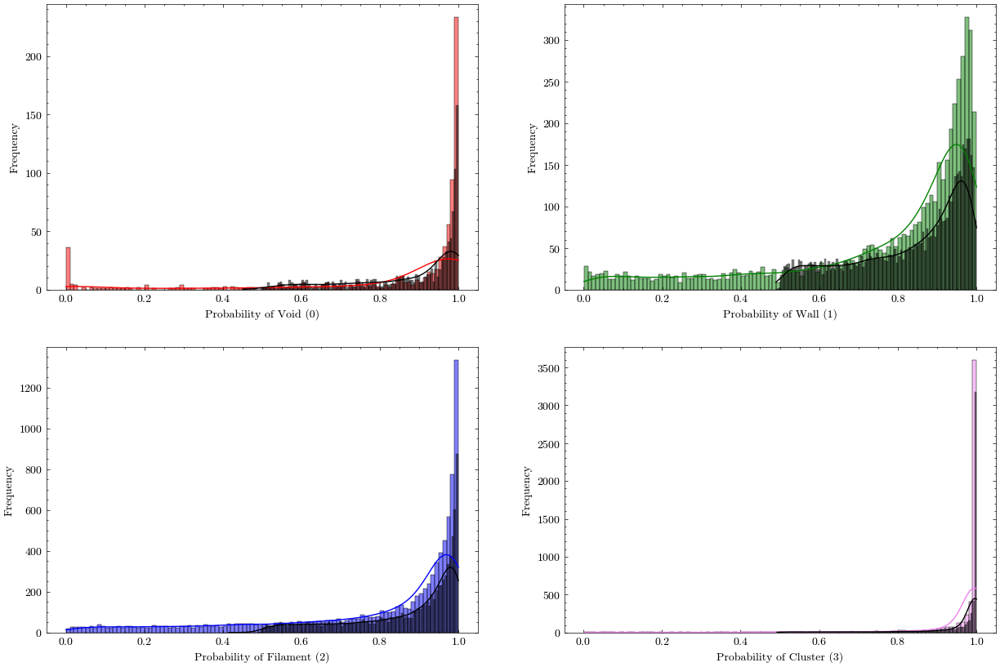

In [102]:
# Visualise decision boundaries using full_probs

from sklearn.metrics import precision_recall_curve
from sklearn.preprocessing import label_binarize
true_colors = ['red', 'green', 'blue', 'violet']
pred_colors = ['purple', 'orange', 'cyan', 'magenta']

y = label_binarize(full_labels.cpu(), classes=[0, 1, 2, 3])
y_score = full_probs.cpu().detach().numpy()

precision = dict()
recall = dict()
thresholds = dict()

for i in range(4):
    precision[i], recall[i], thresholds[i] = precision_recall_curve(y[:, i], y_score[:, i])

fig, ax = plt.subplots(figsize=(7,7))
for i in range(4):
    ax.plot(recall[i], precision[i], label=f'{classes[i]}', color=true_colors[i])
# ax.axline((0,1),(1,0),color='k',ls='dashed')
ax.set_xlabel('Recall')
ax.set_ylabel('Precision')
ax.legend()
plt.show()

# histogram with smooth kde on x axis for each class of true color galaxies that are present in both the true and predicted classes and predicted color galaxies that are only present in the predicted class

fig, ax = plt.subplots(2,2, figsize=(15,10))


for i in range(4):
    sns.histplot(full_probs.cpu().detach()[full_labels.cpu()==i][:,i], bins=100, color=true_colors[i], alpha=0.5, label=f'{classes[i]}', kde=True, ax=ax[i//2, i%2])
    sns.histplot(full_probs.cpu().detach()[full_predicted.cpu()==i][:,i], bins=100, color='k', alpha=0.5, label=f'{classes[i]}', kde=True, ax=ax[i//2, i%2])

    # ax[i//2, i%2].hist(full_probs.detach()[full_labels==i][:,i], bins=100, color=true_colors[i], alpha=0.5, label=f'{classes[i]}')
    # ax[i//2, i%2].scatter(full_probs.detach()[:,i], np.random.rand(len(full_probs.detach())), c=[true_colors[j] if j==i else 'black' for j in full_labels], s=1)
    # ax[i//2, i%2].hist(full_probs.detach()[full_predicted==i][:,i], bins=100, color=pred_colors[i], alpha=0.5, label=f'{classes[i]}')

    ax[i//2, i%2].set_xlabel(f'Probability of {classes[i]}')
    ax[i//2, i%2].set_ylabel('Frequency')
    # ax[i//2, i%2].set_xlabel(f'Probability of {classes[i]}')
    # ax[i//2, i%2].set_ylabel('Random')
    # ax[i//2, i%2].set_xscale('log')
plt.show()


In [103]:
# function to calculate class conditional probabilities P(X|Y=c) for each class
def class_conditional(X, bandwidth=0.1):
    '''
    Calculate the class conditional
    X: features
    bandwidth: bandwidth of the kernel density estimator
    '''
    kde = KernelDensity(kernel='gaussian', bandwidth=bandwidth)
    kde.fit(X)
    return kde

# function to calculate class priors P(Y=c)
def class_priors(Y):
    '''
    Calculate the class priors
    Y: targets
    '''
    priors = Y.value_counts(normalize=True)
    return np.array(priors)

# function to calculate the posterior probability P(Y=c|X)
def posterior(X, class_kdes, cp):
    '''
    Calculate the posterior probability
    X: features
    class_kdes: class conditional
    cp: class priors
    '''
    n_classes = len(class_kdes)
    n_samples = X.shape[0]

    densities = np.zeros((n_samples, n_classes)) # initialize array to hold densities

    # calculating P(X|Y=c) for each class
    for c in range(n_classes):
        densities[:, c] = np.exp(class_kdes[c].score_samples(X)) # log density to density

    # calculate the marginal
    evidence = np.dot(densities, cp)

    # calculate the posterior
    posteriors = densities * cp / evidence[:, None]
    return posteriors

# function for Bayes error rate
def bayes_error_rate(posteriors):
    '''
    Calculate the Bayes error rate
    '''
    max_posterior = np.max(posteriors, axis=1) # find the maximum posterior probability
    error_rate = 1 - np.mean(max_posterior) # calculate the error rate
    return error_rate


In [104]:
frequencies = dict(train_y.value_counts(normalize=True))
class_p = np.array([frequencies[0], frequencies[1], frequencies[2], frequencies[3]])
class_p

array([0.0362611 , 0.24119022, 0.45086774, 0.27168095])

In [421]:
classes = np.unique(train_y) # unique classes
n_classes = len(classes) # number of classes
cp = [1,1,1,1]#class_p#class_priors(train_y) # P(Y) for each class switch between uniform and count based priorsnp.array([0.25, 0.25, 0.25, 0.25])#

# calculate class conditional densities
class_kdes = []
for c in classes:
    X_c = train_x[train_y == c] # features for class c
    kde_c = class_conditional(X_c, bandwidth=0.10680004325145757) # class conditional for class c
    class_kdes.append(kde_c)

# calculate posterior probabilities
posteriors = posterior(test_x, class_kdes, cp) # test set

E_B = bayes_error_rate(posteriors)

print(f'Theoretical accuracy limit for test set from Bayes error rate: {100*(1 - E_B):.2f}%')

KeyboardInterrupt: 

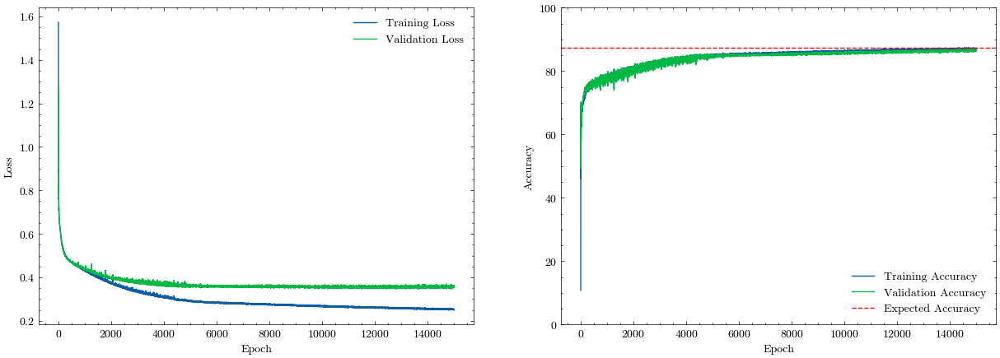

In [107]:
# Plotting training/validation loss and accuracy
fig, ax = plt.subplots(1,2, figsize=(15,5))
ax[0].plot(full_train_loss, label='Training Loss')
ax[0].plot(full_val_loss, label='Validation Loss')
ax[0].set_xlabel('Epoch')
ax[0].set_ylabel('Loss')
ax[0].legend()
ax[1].plot(full_train_acc, label='Training Accuracy')
ax[1].plot(full_val_acc, label='Validation Accuracy')
ax[1].axhline(A_max*100, color='red', linestyle='--', label='Expected Accuracy')
ax[1].set_ylim(0, 100)
ax[1].set_xlabel('Epoch')
ax[1].set_ylabel('Accuracy')
ax[1].legend()
plt.show()

In [108]:
from torcheval.metrics.functional import multiclass_confusion_matrix, multiclass_accuracy, multiclass_precision, multiclass_recall



ModuleNotFoundError: No module named 'torcheval'

In [109]:
print(len(full_predicted), len(full_labels))
print(multiclass_confusion_matrix(torch.tensor(full_predicted), torch.tensor(full_labels),4))
print(multiclass_accuracy(torch.tensor(full_predicted), torch.tensor(full_labels)))
print(multiclass_precision(torch.tensor(full_predicted), torch.tensor(full_labels)))
print(multiclass_recall(torch.tensor(full_predicted), torch.tensor(full_labels)))

20633 20633


NameError: name 'multiclass_confusion_matrix' is not defined

In [645]:
plt.hist(dict(netx.degree).values())

NameError: name 'netx' is not defined

In [49]:
# testing full batch gnn implementation with cora dataset 
from torch_geometric.datasets import Planetoid
from torch_geometric.utils import to_dense_adj

class CoraDataset(object):
    def __init__(self):
        super(CoraDataset, self).__init__()
        cora_pyg = Planetoid(root='/tmp/Cora', name='Cora', split="full")
        self.cora_data = cora_pyg[0]
        self.train_mask = self.cora_data.train_mask
        self.valid_mask = self.cora_data.val_mask
        self.test_mask = self.cora_data.test_mask

    def train_val_test_split(self):
        train_x = self.cora_data.x[self.cora_data.train_mask]
        train_y = self.cora_data.y[self.cora_data.train_mask]

        valid_x = self.cora_data.x[self.cora_data.val_mask]
        valid_y = self.cora_data.y[self.cora_data.val_mask]

        test_x = self.cora_data.x[self.cora_data.test_mask]
        test_y = self.cora_data.y[self.cora_data.test_mask]
        return train_x, train_y, valid_x, valid_y, test_x, test_y

    def get_fullx(self):
        return self.cora_data.x

    def get_adjacency_matrix(self):
        # We will ignore this for the first part
        adj = to_dense_adj(self.cora_data.edge_index)[0]
        return adj
    
cora_data = CoraDataset()

Processing...
Done!


In [ ]:
# full-batch training and testing functions

def train_gcn_full(model, data, optimiser, criterion):
    model.train()
    optimiser.zero_grad()
    output = model(data.x, data.edge_index) # remember to pass the edge_attr as we are weighting the edges by their distance
    loss = criterion(output[data.train_mask], data.y[data.train_mask])
    loss.backward()
    optimiser.step() # update the weights based on the loss!
    _, predicted = torch.max(output[data.train_mask], 1)
    correct = (predicted == data.y[data.train_mask]).sum().item()
    total = data.y[data.train_mask].size(0)

    # validation
    model.eval()
    output = model(data.x, data.edge_index)
    val_loss = criterion(output[data.val_mask], data.y[data.val_mask])
    _, val_predicted = torch.max(output[data.val_mask], 1)
    val_correct = (val_predicted == data.y[data.val_mask]).sum().item()
    val_total = data.y[data.val_mask].size(0)
    model.train()

    # print(f'Training Loss: {loss.item():.4f} - Training Accuracy: {100 * correct / total:.2f}% - Validation Loss: {val_loss.item():.4f} - Validation Accuracy: {100 * val_correct / val_total:.2f}%')
    return loss, val_loss, 100 * correct / total, 100 * val_correct / val_total

def test_gcn_full(model, data):
    model.eval()
    output = model(data.x, data.edge_index)
    _, predicted = torch.max(output[data.test_mask], 1)
    correct = (predicted == data.y[data.test_mask]).sum().item()
    total = data.y[data.test_mask].size(0)
    print(f'Test Accuracy: {100 * correct / total:.2f}%')
    return predicted, data.y[data.test_mask]

In [50]:
cora_data.cora_data

Data(x=[2708, 1433], edge_index=[2, 10556], y=[2708], train_mask=[2708], val_mask=[2708], test_mask=[2708])

In [58]:
cora_train_x, cora_train_y, cora_valid_x, cora_valid_y, cora_test_x, cora_test_y = cora_data.train_val_test_split()


In [59]:
train_x.shape[-1]

10

In [76]:
#GCN
model = SimpleGNN(1433, 7).to('cpu')
optimiser = optim.Adam(model.parameters(), lr=0.00025)
criterion = nn.CrossEntropyLoss()#weight=torch.tensor([0.63, 0.17, 0.09, 0.11]))
num_epochs = 3000
full_train_loss = []
full_val_loss = []
full_train_acc = []
full_val_acc = []
cora_graph_cpu=cora_data.cora_data.to('cpu')
for epoch in range(num_epochs):
    train_loss, val_loss,train_acc,val_acc,_ = train_gcn_full(model, cora_graph, optimiser, criterion, return_attention=False)
    full_train_loss.append(train_loss.item())
    full_val_loss.append(val_loss.item())
    full_train_acc.append(train_acc)
    full_val_acc.append(val_acc)
    if (epoch+1) % 100 == 0:
        print(f'Epoch {epoch+1}/{num_epochs} - Training Loss: {train_loss:.4f} - Validation Loss: {val_loss:.4f} - Training Accuracy: {train_acc:.2f}% - Validation Accuracy: {val_acc:.2f}%')

full_predicted, full_labels = test_gcn_full(model, cora_data.cora_data)

/tmp/ipykernel_1679447/2734133257.py:28: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Epoch 100/3000 - Training Loss: 1.7346 - Validation Loss: 1.7512 - Training Accuracy: 42.80% - Validation Accuracy: 41.60%
Epoch 200/3000 - Training Loss: 1.4376 - Validation Loss: 1.4447 - Training Accuracy: 57.12% - Validation Accuracy: 61.80%
Epoch 300/3000 - Training Loss: 1.0902 - Validation Loss: 1.1129 - Training Accuracy: 75.08% - Validation Accuracy: 80.20%
Epoch 400/3000 - Training Loss: 0.8258 - Validation Loss: 0.8436 - Training Accuracy: 82.45% - Validation Accuracy: 83.40%
Epoch 500/3000 - Training Loss: 0.6467 - Validation Loss: 0.6699 - Training Accuracy: 85.10% - Validation Accuracy: 85.20%
Epoch 600/3000 - Training Loss: 0.5282 - Validation Loss: 0.5669 - Training Accuracy: 87.42% - Validation Accuracy: 85.60%
Epoch 700/3000 - Training Loss: 0.4467 - Validation Loss: 0.5066 - Training Accuracy: 88.25% - Validation Accuracy: 86.40%
Epoch 800/3000 - Training Loss: 0.4076 - Validation Loss: 0.4733 - Training Accuracy: 88.99% - Validation Accuracy: 87.80%
Epoch 900/3000 -

ValueError: too many values to unpack (expected 2)

In [64]:
#GAT

model = SimpleGAT(1433, 7, num_heads=4).to(device)
cora_graph = cora_data.cora_data.to(device)
optimiser = optim.Adam(model.parameters(), lr=0.00025) #0.3e-2

# scheduler = ReduceLROnPlateau(
#     optimiser,
#     mode='min',
#     factor=0.7,            # decay slowly
#     patience=200,          # wait longer
#     threshold=1.5e-3,        # ignore tiny changes. 0.1% change to count as an improvement as mode is 'rel'
#     threshold_mode='rel',  # relative change
#     cooldown=50,           # allow some recovery time
#     min_lr=5e-4,           # avoid freezing
#     verbose=True
# )

criterion = nn.CrossEntropyLoss()
num_epochs = 3000
cora_train_loss = []
cora_val_loss = []
cora_train_acc = []
cora_val_acc = []

# Track the initial learning rate
last_lr = optimiser.param_groups[0]['lr']

for epoch in range(num_epochs):
    train_loss, val_loss,train_acc,val_acc, _ = train_gcn_full(model, cora_graph, optimiser, criterion, return_attention=False)
    cora_train_loss.append(train_loss.item())
    cora_val_loss.append(val_loss.item())
    cora_train_acc.append(train_acc)
    cora_val_acc.append(val_acc)

    # scheduler.step(val_loss.item()) # reduce the learning rate if the validation loss does not improve

    # Check for learning rate change
    current_lr = optimiser.param_groups[0]['lr']
    if current_lr != last_lr:
        print(f"[Epoch {epoch+1}] Learning rate changed from {last_lr:.6e} → {current_lr:.6e}")
        last_lr = current_lr

    if (epoch+1) % 100 == 0:
        print(f"Allocated: {torch.cuda.memory_allocated() / 1e9:.2f} GB | Reserved: {torch.cuda.memory_reserved() / 1e9:.2f} GB")
        print(f'Epoch {epoch+1}/{num_epochs} - Training Loss: {train_loss:.4f} - Validation Loss: {val_loss:.4f} - Training Accuracy: {train_acc:.2f}% - Validation Accuracy: {val_acc:.2f}%')



/tmp/ipykernel_1679447/2734133257.py:28: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Allocated: 0.04 GB | Reserved: 0.12 GB
Epoch 100/3000 - Training Loss: 0.2133 - Validation Loss: 0.4766 - Training Accuracy: 94.21% - Validation Accuracy: 85.40%
Allocated: 0.04 GB | Reserved: 0.12 GB
Epoch 200/3000 - Training Loss: 0.0865 - Validation Loss: 0.5602 - Training Accuracy: 97.19% - Validation Accuracy: 84.60%
Allocated: 0.04 GB | Reserved: 0.12 GB
Epoch 300/3000 - Training Loss: 0.0485 - Validation Loss: 0.6490 - Training Accuracy: 98.51% - Validation Accuracy: 83.60%
Allocated: 0.04 GB | Reserved: 0.12 GB
Epoch 400/3000 - Training Loss: 0.0353 - Validation Loss: 0.7152 - Training Accuracy: 99.01% - Validation Accuracy: 83.40%
Allocated: 0.04 GB | Reserved: 0.12 GB
Epoch 500/3000 - Training Loss: 0.0218 - Validation Loss: 0.7712 - Training Accuracy: 99.34% - Validation Accuracy: 84.00%
Allocated: 0.04 GB | Reserved: 0.12 GB
Epoch 600/3000 - Training Loss: 0.0155 - Validation Loss: 0.8318 - Training Accuracy: 99.50% - Validation Accuracy: 82.40%
Allocated: 0.04 GB | Reserve

RuntimeError: Expected all tensors to be on the same device, but found at least two devices, cuda:0 and cpu! (when checking argument for argument mat1 in method wrapper_CUDA_addmm)

In [65]:
cora_predicted, cora_labels, cora_probs, cora_attn_layers = test_gcn_full(model, cora_graph, return_attention=True)

Test Accuracy: 79.80%


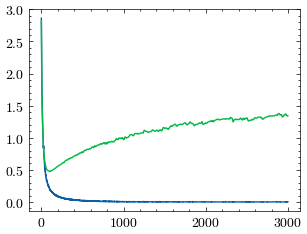

In [71]:
plt.plot(cora_train_loss, label='train_loss')
plt.plot(cora_val_loss, label='val_loss')

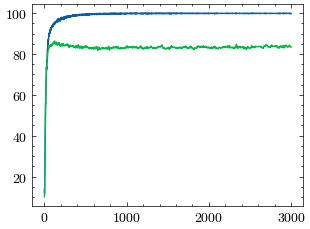

In [73]:
plt.plot(cora_train_acc, label='train_acc')
plt.plot(cora_val_acc, label='val_acc')